<a href="https://colab.research.google.com/github/MaDufie/ml_journey/blob/feature%2Feda-with-graph-theory/flight_arrival_delay_prediction_with_graph_and_weather_data.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Flight Arrival Delay Prediction with Weather Data**

---



In [3]:
# connect to drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# **Data Preparation**

##  Importing dependencies

In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from pandas.plotting import scatter_matrix
from sklearn.feature_selection import mutual_info_classif
from sklearn.model_selection import KFold, cross_val_score
from sklearn.model_selection import cross_validate
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import networkx as nx
from xgboost import XGBClassifier

## Loading the flight & weather dataset


In [6]:
flight_df = pd.read_csv('/content/drive/MyDrive/My ML Journey/flight_arrival_delay_prediction/T_ONTIME_MARKETING_2405.csv')
weather_df = pd.read_csv('/content/drive/MyDrive/My ML Journey/flight_arrival_delay_prediction/airport_weather_2405.csv')

## Exploring the Flight Data


### Flight Dataset Information

In [ ]:
flight_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 649428 entries, 0 to 649427
Data columns (total 38 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   YEAR                 649428 non-null  int64  
 1   QUARTER              649428 non-null  int64  
 2   MONTH                649428 non-null  int64  
 3   DAY_OF_MONTH         649428 non-null  int64  
 4   DAY_OF_WEEK          649428 non-null  int64  
 5   FL_DATE              649428 non-null  object 
 6   MKT_UNIQUE_CARRIER   649428 non-null  object 
 7   MKT_CARRIER_FL_NUM   649428 non-null  int64  
 8   ORIGIN_AIRPORT_ID    649428 non-null  int64  
 9   ORIGIN               649428 non-null  object 
 10  ORIGIN_CITY_NAME     649428 non-null  object 
 11  ORIGIN_STATE_ABR     649428 non-null  object 
 12  DEST_AIRPORT_ID      649428 non-null  int64  
 13  DEST                 649428 non-null  object 
 14  DEST_CITY_NAME       649428 non-null  object 
 15  DEST_STATE_ABR   

In [ ]:
flight_df.head()

,YEAR,QUARTER,MONTH,DAY_OF_MONTH,DAY_OF_WEEK,FL_DATE,MKT_UNIQUE_CARRIER,MKT_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN,...,CRS_ELAPSED_TIME,ACTUAL_ELAPSED_TIME,AIR_TIME,FLIGHTS,DISTANCE,CARRIER_DELAY,WEATHER_DELAY,NAS_DELAY,SECURITY_DELAY,LATE_AIRCRAFT_DELAY
0,2024,2,5,1,3,5/1/2024 12:00:00 AM,AA,1,12478,JFK,...,389.0,363.0,336.0,1.0,2475.0,NaN,NaN,NaN,NaN,NaN
1,2024,2,5,1,3,5/1/2024 12:00:00 AM,AA,10,12892,LAX,...,330.0,326.0,298.0,1.0,2475.0,NaN,NaN,NaN,NaN,NaN
2,2024,2,5,1,3,5/1/2024 12:00:00 AM,AA,1002,15919,XNA,...,82.0,71.0,48.0,1.0,280.0,NaN,NaN,NaN,NaN,NaN
3,2024,2,5,1,3,5/1/2024 12:00:00 AM,AA,1003,11292,DEN,...,237.0,234.0,207.0,1.0,1709.0,NaN,NaN,NaN,NaN,NaN
4,2024,2,5,1,3,5/1/2024 12:00:00 AM,AA,1004,10721,BOS,...,149.0,157.0,113.0,1.0,728.0,NaN,NaN,NaN,NaN,NaN


### Descriptive Statistics

In [ ]:
flight_df.describe()

,YEAR,QUARTER,MONTH,DAY_OF_MONTH,DAY_OF_WEEK,MKT_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,DEST_AIRPORT_ID,CRS_DEP_TIME,DEP_TIME,...,CRS_ELAPSED_TIME,ACTUAL_ELAPSED_TIME,AIR_TIME,FLIGHTS,DISTANCE,CARRIER_DELAY,WEATHER_DELAY,NAS_DELAY,SECURITY_DELAY,LATE_AIRCRAFT_DELAY
count,649428.0,649428.0,649428.0,649428.000000,649428.000000,649428.000000,649428.000000,649428.000000,649428.000000,640475.000000,...,649428.000000,637694.000000,637694.000000,649428.0,649428.000000,166497.000000,166497.000000,166497.000000,166497.000000,166497.000000
mean,2024.0,2.0,5.0,16.065898,3.972425,2688.154946,12649.072784,12648.982694,1331.919946,1339.197987,...,142.537685,138.717684,112.402165,1.0,805.557563,22.812321,5.751737,15.396398,0.104669,33.265056
std,0.0,0.0,0.0,8.962458,1.913141,1768.360782,1527.080596,1527.131838,492.395536,514.352596,...,71.238202,71.935840,69.965607,0.0,589.039647,71.689198,36.775560,35.239231,3.320672,67.775335
min,2024.0,2.0,5.0,1.000000,1.000000,1.000000,10135.000000,10135.000000,1.000000,1.000000,...,22.000000,16.000000,8.000000,1.0,31.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2024.0,2.0,5.0,8.000000,2.000000,1226.000000,11292.000000,11292.000000,912.000000,913.000000,...,90.000000,86.000000,61.000000,1.0,376.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,2024.0,2.0,5.0,16.000000,4.000000,2335.000000,12889.000000,12889.000000,1325.000000,1330.000000,...,125.000000,121.000000,95.000000,1.0,647.000000,2.000000,0.000000,1.000000,0.000000,7.000000
75%,2024.0,2.0,5.0,24.000000,5.000000,4060.000000,14027.000000,14027.000000,1740.000000,1754.000000,...,172.000000,169.000000,142.000000,1.0,1042.000000,19.000000,0.000000,18.000000,0.000000,40.000000
max,2024.0,2.0,5.0,31.000000,7.000000,9694.000000,16869.000000,16869.000000,2359.000000,2400.000000,...,670.000000,723.000000,649.000000,1.0,5095.000000,2911.000000,1728.000000,1320.000000,656.000000,2034.000000


### Checking for missing values and duplicates


In [ ]:
flight_df.isnull().sum()

,0
YEAR,0
QUARTER,0
MONTH,0
DAY_OF_MONTH,0
DAY_OF_WEEK,0
FL_DATE,0
MKT_UNIQUE_CARRIER,0
MKT_CARRIER_FL_NUM,0
ORIGIN_AIRPORT_ID,0
ORIGIN,0


In [ ]:
flight_df.nunique()

,0
YEAR,1
QUARTER,1
MONTH,1
DAY_OF_MONTH,31
DAY_OF_WEEK,7
FL_DATE,31
MKT_UNIQUE_CARRIER,10
MKT_CARRIER_FL_NUM,6402
ORIGIN_AIRPORT_ID,352
ORIGIN,352


In [ ]:
# Checking for duplicate rows
flight_duplicates = flight_df.duplicated()

# Counting the number of duplicate rows
num_flight_duplicates = flight_duplicates.sum()

# Displaying the duplicate rows
flight_duplicate_rows = flight_df[flight_duplicates]

print(f"Number of duplicate Flight rows: {num_flight_duplicates}")
print("Duplicate Flight rows:")
print(flight_duplicate_rows)

Number of duplicate Flight rows: 0
Duplicate Flight rows:
Empty DataFrame
Columns: [YEAR, QUARTER, MONTH, DAY_OF_MONTH, DAY_OF_WEEK, FL_DATE, MKT_UNIQUE_CARRIER, MKT_CARRIER_FL_NUM, ORIGIN_AIRPORT_ID, ORIGIN, ORIGIN_CITY_NAME, ORIGIN_STATE_ABR, DEST_AIRPORT_ID, DEST, DEST_CITY_NAME, DEST_STATE_ABR, CRS_DEP_TIME, DEP_TIME, DEP_DELAY, DEP_DELAY_NEW, DEP_DELAY_GROUP, TAXI_OUT, TAXI_IN, CRS_ARR_TIME, ARR_TIME, ARR_DELAY, ARR_DELAY_NEW, ARR_DELAY_GROUP, CRS_ELAPSED_TIME, ACTUAL_ELAPSED_TIME, AIR_TIME, FLIGHTS, DISTANCE, CARRIER_DELAY, WEATHER_DELAY, NAS_DELAY, SECURITY_DELAY, LATE_AIRCRAFT_DELAY]
Index: []

[0 rows x 38 columns]


### Cleaning Flight Data

In [7]:
# Dropping unneeded columns in flight_df and remove rows with null values in 'ARR_DELAY_NEW'
flight_df_new = flight_df.drop(columns=['FL_DATE', 'FLIGHTS', 'DEP_DELAY_GROUP', 'ARR_DELAY_GROUP'])
flight_df_new = flight_df_new.dropna(subset=['ARR_DELAY_NEW'])

# Removing rows where 'DAY_OF_WEEK' has a value of 9
flight_df_new = flight_df_new[flight_df_new['DAY_OF_WEEK'] != 9]

# Resetting the index after dropping rows
flight_df_new.reset_index(drop=True, inplace=True)

# Converting time columns (CRS_DEP_TIME, DEP_TIME, CRS_ARR_TIME, ARR_TIME) to hour only (HH)
def extract_hour(time_val):
    return int(time_val // 100)

time_columns = ['CRS_DEP_TIME', 'DEP_TIME', 'CRS_ARR_TIME', 'ARR_TIME']
for col in time_columns:
    flight_df_new[col + '_HH'] = flight_df_new[col].apply(extract_hour)

# changing the NaN to 0 for the following columns CARRIER_DELAY, WEATHER_DELAY, NAS_DELAY, SECURITY_DELAY, LATE_AIRCRAFT_DELAY
columns_to_fill = ['CARRIER_DELAY', 'WEATHER_DELAY', 'NAS_DELAY', 'SECURITY_DELAY', 'LATE_AIRCRAFT_DELAY']
flight_df_new[columns_to_fill] = flight_df_new[columns_to_fill].fillna(0)

# removing outliers with zscore
from scipy import stats
z_scores = np.abs(stats.zscore(flight_df_new['ARR_DELAY_NEW']))
flight_df_new = flight_df_new[z_scores < 3]

outliers = flight_df_new[z_scores >= 3]
print(f"Number of outliers: {len(outliers)}")

Number of outliers: 0


<ipython-input-7-fba7e9e7b2bb>:28: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  outliers = flight_df_new[z_scores >= 3]


In [7]:
flight_df_new.sample(10)

,YEAR,QUARTER,MONTH,DAY_OF_MONTH,DAY_OF_WEEK,MKT_UNIQUE_CARRIER,MKT_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN,ORIGIN_CITY_NAME,...,DISTANCE,CARRIER_DELAY,WEATHER_DELAY,NAS_DELAY,SECURITY_DELAY,LATE_AIRCRAFT_DELAY,CRS_DEP_TIME_HH,DEP_TIME_HH,CRS_ARR_TIME_HH,ARR_TIME_HH
88706,2024,2,5,5,7,DL,1425,15304,TPA,"Tampa, FL",...,406.0,0.0,0.0,31.0,0.0,0.0,18,19,20,21
525665,2024,2,5,26,7,F9,4650,10397,ATL,"Atlanta, GA",...,795.0,0.0,0.0,0.0,0.0,0.0,15,15,18,17
452759,2024,2,5,22,3,WN,949,15016,STL,"St. Louis, MO",...,1047.0,0.0,0.0,0.0,0.0,0.0,8,8,12,12
361684,2024,2,5,18,6,HA,144,12982,LIH,"Lihue, HI",...,102.0,0.0,0.0,0.0,0.0,0.0,8,8,9,9
387129,2024,2,5,19,7,WN,1680,12954,LGB,"Long Beach, CA",...,854.0,0.0,0.0,0.0,0.0,0.0,15,15,18,18
410009,2024,2,5,20,1,WN,3504,14679,SAN,"San Diego, CA",...,446.0,0.0,0.0,0.0,0.0,0.0,20,21,22,22
627663,2024,2,5,31,5,DL,988,10721,BOS,"Boston, MA",...,1185.0,15.0,0.0,0.0,0.0,169.0,11,15,15,18
503722,2024,2,5,25,6,DL,2212,13487,MSP,"Minneapolis, MN",...,1426.0,0.0,0.0,0.0,0.0,0.0,15,15,17,17
116637,2024,2,5,6,1,UA,2008,13930,ORD,"Chicago, IL",...,606.0,0.0,0.0,0.0,0.0,0.0,7,7,10,10
176948,2024,2,5,9,4,NK,349,12889,LAS,"Las Vegas, NV",...,1910.0,0.0,0.0,0.0,0.0,0.0,21,21,4,4


In [ ]:
flight_df_new.isnull().sum()

,0
YEAR,0
QUARTER,0
MONTH,0
DAY_OF_MONTH,0
DAY_OF_WEEK,0
MKT_UNIQUE_CARRIER,0
MKT_CARRIER_FL_NUM,0
ORIGIN_AIRPORT_ID,0
ORIGIN,0
ORIGIN_CITY_NAME,0


In [ ]:
flight_df_new.columns

Index(['YEAR', 'QUARTER', 'MONTH', 'DAY_OF_MONTH', 'DAY_OF_WEEK',
       'MKT_UNIQUE_CARRIER', 'MKT_CARRIER_FL_NUM', 'ORIGIN_AIRPORT_ID',
       'ORIGIN', 'ORIGIN_CITY_NAME', 'ORIGIN_STATE_ABR', 'DEST_AIRPORT_ID',
       'DEST', 'DEST_CITY_NAME', 'DEST_STATE_ABR', 'CRS_DEP_TIME', 'DEP_TIME',
       'DEP_DELAY', 'DEP_DELAY_NEW', 'TAXI_OUT', 'TAXI_IN', 'CRS_ARR_TIME',
       'ARR_TIME', 'ARR_DELAY', 'ARR_DELAY_NEW', 'CRS_ELAPSED_TIME',
       'ACTUAL_ELAPSED_TIME', 'AIR_TIME', 'DISTANCE', 'CARRIER_DELAY',
       'WEATHER_DELAY', 'NAS_DELAY', 'SECURITY_DELAY', 'LATE_AIRCRAFT_DELAY',
       'CRS_DEP_TIME_HH', 'DEP_TIME_HH', 'CRS_ARR_TIME_HH', 'ARR_TIME_HH'],
      dtype='object')

array([[<Axes: title={'center': 'YEAR'}>,
        <Axes: title={'center': 'QUARTER'}>,
        <Axes: title={'center': 'MONTH'}>,
        <Axes: title={'center': 'DAY_OF_MONTH'}>,
        <Axes: title={'center': 'DAY_OF_WEEK'}>],
       [<Axes: title={'center': 'MKT_CARRIER_FL_NUM'}>,
        <Axes: title={'center': 'ORIGIN_AIRPORT_ID'}>,
        <Axes: title={'center': 'DEST_AIRPORT_ID'}>,
        <Axes: title={'center': 'CRS_DEP_TIME_HH'}>,
        <Axes: title={'center': 'DEP_TIME_HH'}>],
       [<Axes: title={'center': 'DEP_DELAY'}>,
        <Axes: title={'center': 'DEP_DELAY_NEW'}>,
        <Axes: title={'center': 'TAXI_OUT'}>,
        <Axes: title={'center': 'TAXI_IN'}>,
        <Axes: title={'center': 'CRS_ARR_TIME_HH'}>],
       [<Axes: title={'center': 'ARR_TIME_HH'}>,
        <Axes: title={'center': 'ARR_DELAY'}>,
        <Axes: title={'center': 'ARR_DELAY_NEW'}>,
        <Axes: title={'center': 'CRS_ELAPSED_TIME'}>,
        <Axes: title={'center': 'ACTUAL_ELAPSED_TIME'}>],
 

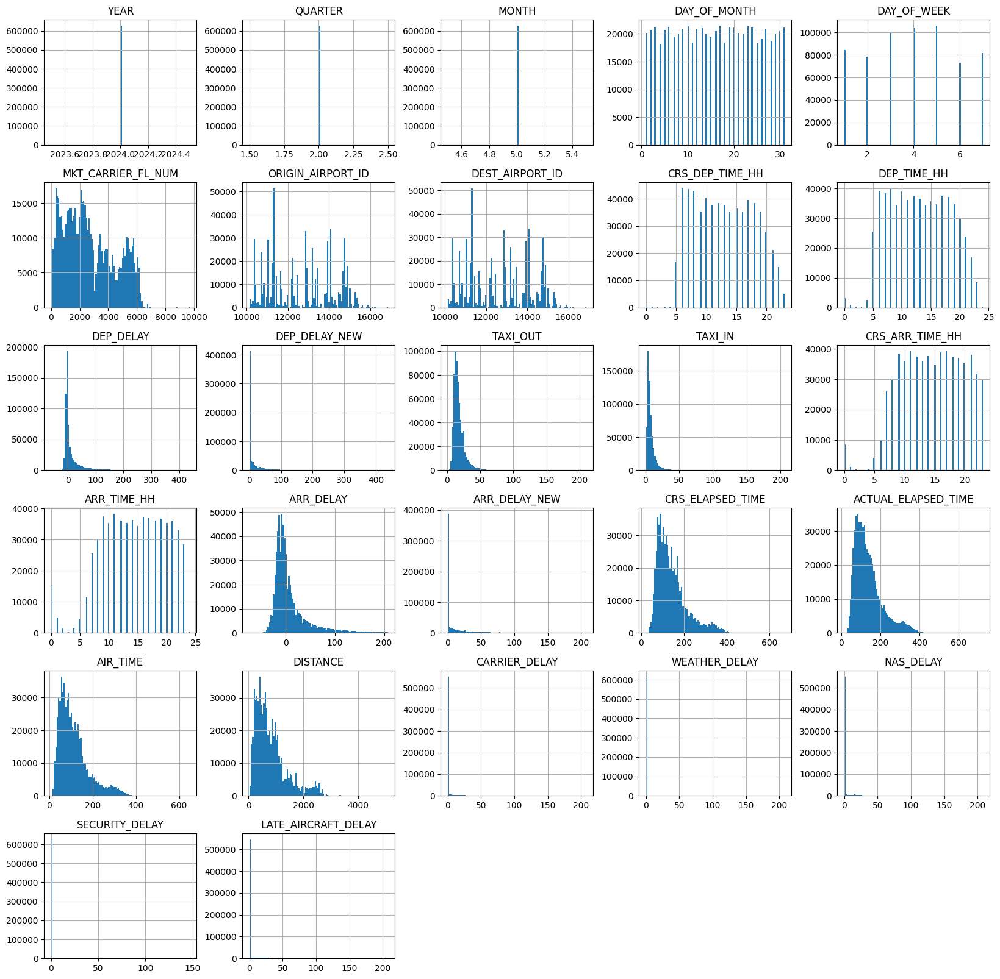

In [ ]:
flight_df_new[['YEAR', 'QUARTER', 'MONTH', 'DAY_OF_MONTH', 'DAY_OF_WEEK',
       'MKT_UNIQUE_CARRIER', 'MKT_CARRIER_FL_NUM', 'ORIGIN_AIRPORT_ID',
       'ORIGIN', 'ORIGIN_CITY_NAME', 'ORIGIN_STATE_ABR', 'DEST_AIRPORT_ID',
       'DEST', 'DEST_CITY_NAME', 'DEST_STATE_ABR', 'CRS_DEP_TIME_HH', 'DEP_TIME_HH',
       'DEP_DELAY', 'DEP_DELAY_NEW', 'TAXI_OUT', 'TAXI_IN', 'CRS_ARR_TIME_HH',
       'ARR_TIME_HH', 'ARR_DELAY', 'ARR_DELAY_NEW', 'CRS_ELAPSED_TIME',
       'ACTUAL_ELAPSED_TIME', 'AIR_TIME', 'DISTANCE', 'CARRIER_DELAY',
       'WEATHER_DELAY', 'NAS_DELAY', 'SECURITY_DELAY', 'LATE_AIRCRAFT_DELAY']].hist(bins=100,figsize=(20,20))

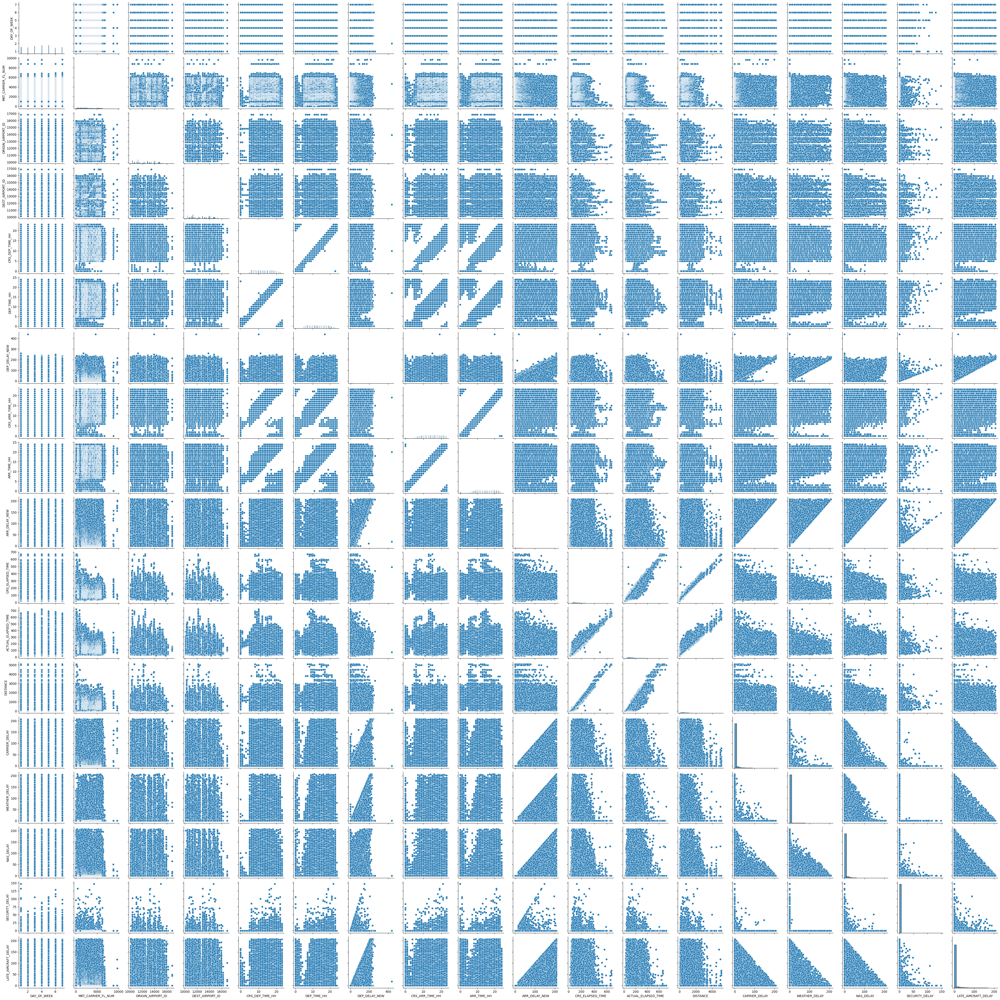

In [ ]:
features = ['DAY_OF_WEEK', 'MKT_CARRIER_FL_NUM', 'ORIGIN_AIRPORT_ID', 'DEST_AIRPORT_ID', 'CRS_DEP_TIME_HH', 'DEP_TIME_HH', 'DEP_DELAY_NEW', 'CRS_ARR_TIME_HH', 'ARR_TIME_HH',
              'ARR_DELAY_NEW', 'CRS_ELAPSED_TIME', 'ACTUAL_ELAPSED_TIME','DISTANCE', 'CARRIER_DELAY', 'WEATHER_DELAY', 'NAS_DELAY', 'SECURITY_DELAY', 'LATE_AIRCRAFT_DELAY' ]
sns.pairplot(flight_df_new[features])

## Feature Engineering fot Flight Data

### Time of Day
*   Creating a new feature to determine if the flight was in the morning or evening


In [8]:
def get_time_of_day(hour):
    if hour is None:
        return None
    if 300 <= hour < 720:  # 5AM to 12PM
        return 'Morning'
    elif 720 <= hour < 1080:  # 12PM to 6PM
        return 'Afternoon'
    elif 1080 <= hour < 1320: # 6PM to 10PM
        return 'Evening'
    else:
        return 'Night'

flight_df_new['CRS_DEP_TIME_OF_DAY'] = flight_df_new['CRS_DEP_TIME'].apply(get_time_of_day)
flight_df_new['CRS_ARR_TIME_OF_DAY'] = flight_df_new['CRS_ARR_TIME'].apply(get_time_of_day)

In [63]:
flight_df_new.head()

,YEAR,QUARTER,MONTH,DAY_OF_MONTH,DAY_OF_WEEK,MKT_UNIQUE_CARRIER,MKT_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN,ORIGIN_CITY_NAME,...,WEATHER_DELAY,NAS_DELAY,SECURITY_DELAY,LATE_AIRCRAFT_DELAY,CRS_DEP_TIME_HH,DEP_TIME_HH,CRS_ARR_TIME_HH,ARR_TIME_HH,CRS_DEP_TIME_OF_DAY,CRS_ARR_TIME_OF_DAY
0,2024,2,5,1,3,AA,1,12478,JFK,"New York, NY",...,0.0,0.0,0.0,0.0,9,9,12,12,Afternoon,Evening
1,2024,2,5,1,3,AA,10,12892,LAX,"Los Angeles, CA",...,0.0,0.0,0.0,0.0,22,22,7,6,Night,Morning
2,2024,2,5,1,3,AA,1002,15919,XNA,"Fayetteville, AR",...,0.0,0.0,0.0,0.0,6,6,7,7,Morning,Afternoon
3,2024,2,5,1,3,AA,1003,11292,DEN,"Denver, CO",...,0.0,0.0,0.0,0.0,0,0,6,6,Night,Morning
4,2024,2,5,1,3,AA,1004,10721,BOS,"Boston, MA",...,0.0,0.0,0.0,0.0,8,7,10,10,Afternoon,Afternoon


### Arrival Delay Class
*   Creating a new column ARR_DELAY_CLASS where the value is 1 if ARR_DELAY_NEW is 15 minutes or more, and 0 if it's less than 15 minutes.

In [9]:
# Using Delayed if ARR_DELAY_NEW is 15 minutes or more
flight_df_new['ARR_DELAY_CLASS'] = flight_df_new['ARR_DELAY_NEW'].apply(lambda x: 1 if x >= 15 else 0)
flight_df_new['ARR_DELAY_CLASS'].value_counts(normalize=True)

,proportion
ARR_DELAY_CLASS,
0,0.750888
1,0.249112


## Exploring the Weather Data


### Weather Data Information

In [26]:
weather_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 261888 entries, 0 to 261887
Data columns (total 22 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   AIRPORT               261888 non-null  object 
 1   YEAR                  261888 non-null  int64  
 2   MONTH                 261888 non-null  int64  
 3   DAY_OF_MONTH          261888 non-null  int64  
 4   TIME                  261888 non-null  int64  
 5   weather_code          261888 non-null  int64  
 6   temperature_2m        261888 non-null  float64
 7   relative_humidity_2m  261888 non-null  int64  
 8   dewpoint_2m           261888 non-null  float64
 9   surface_pressure      261888 non-null  float64
 10  precipitation         261888 non-null  float64
 11  rain                  261888 non-null  float64
 12  snowfall              261888 non-null  float64
 13  cloudcover            261888 non-null  int64  
 14  cloudcover_low        261888 non-null  int64  
 15  

In [31]:
weather_df.head()

,AIRPORT,YEAR,MONTH,DAY_OF_MONTH,TIME,weather_code,temperature_2m,relative_humidity_2m,dewpoint_2m,surface_pressure,...,snowfall,cloudcover,cloudcover_low,cloud_cover_mid,cloud_cover_high,wind_speed_10m,wind_speed_100m,wind_direction_10m,wind_direction_100m,wind_gusts_10m
0,ABE,2024,5,1,0,2,17.1,91,15.7,997.9,...,0.0,57,3,40,100,9.2,15.5,315,329,16.2
1,ABE,2024,5,1,100,3,16.4,92,15.1,997.9,...,0.0,91,1,100,100,7.2,13.8,307,319,16.2
2,ABE,2024,5,1,200,1,15.7,92,14.4,997.5,...,0.0,25,0,2,80,8.8,17.8,305,312,15.8
3,ABE,2024,5,1,300,1,14.7,93,13.5,997.4,...,0.0,30,0,0,100,9.9,21.1,314,317,17.3
4,ABE,2024,5,1,400,1,14.5,90,13.0,998.0,...,0.0,30,0,0,100,10.5,22.8,319,325,18.7


### Descriptive Analysis

In [28]:
weather_df.describe()

,YEAR,MONTH,DAY_OF_MONTH,TIME,weather_code,temperature_2m,relative_humidity_2m,dewpoint_2m,surface_pressure,precipitation,...,snowfall,cloudcover,cloudcover_low,cloud_cover_mid,cloud_cover_high,wind_speed_10m,wind_speed_100m,wind_direction_10m,wind_direction_100m,wind_gusts_10m
count,261888.0,261888.0,261888.000000,261888.000000,261888.000000,261888.000000,261888.000000,261888.000000,261888.000000,261888.000000,...,261888.000000,261888.000000,261888.000000,261888.000000,261888.000000,261888.000000,261888.000000,261888.000000,261888.000000,261888.000000
mean,2024.0,5.0,16.000000,1150.000000,9.537856,17.821654,68.093792,10.627712,971.475876,0.137411,...,0.002004,37.937775,20.113304,22.036932,36.439318,12.077124,19.188830,186.821912,188.151378,25.089671
std,0.0,0.0,8.944289,692.219977,19.793976,7.769752,22.703566,8.440369,56.081977,0.751771,...,0.039601,36.554399,34.249564,34.157058,43.269231,6.778487,9.975764,94.633721,94.542306,12.193605
min,2024.0,5.0,1.000000,0.000000,0.000000,-16.000000,2.000000,-25.900000,751.800000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.700000
25%,2024.0,5.0,8.000000,575.000000,0.000000,12.400000,53.000000,5.000000,967.100000,0.000000,...,0.000000,3.000000,0.000000,0.000000,0.000000,7.100000,11.800000,115.000000,117.000000,15.800000
50%,2024.0,5.0,16.000000,1150.000000,1.000000,18.300000,72.000000,11.000000,990.300000,0.000000,...,0.000000,29.000000,0.000000,2.000000,6.000000,10.800000,18.500000,185.000000,188.000000,23.400000
75%,2024.0,5.0,24.000000,1725.000000,3.000000,23.600000,87.000000,17.500000,1008.400000,0.000000,...,0.000000,71.000000,21.000000,29.000000,94.000000,15.800000,25.300000,263.000000,264.000000,32.400000
max,2024.0,5.0,31.000000,2300.000000,75.000000,41.900000,100.000000,27.300000,1034.900000,37.400000,...,3.850000,100.000000,100.000000,100.000000,100.000000,65.200000,95.100000,360.000000,360.000000,108.700000


In [ ]:
weather_df.nunique()

,0
AIRPORT,352
YEAR,1
MONTH,1
DAY_OF_MONTH,31
TIME,24
weather_code,13
temperature_2m,576
relative_humidity_2m,99
dewpoint_2m,490
surface_pressure,2792


### Checking for duplicate rows

In [29]:
weather_duplicates = weather_df.duplicated()
num_weather_duplicates = weather_duplicates.sum()
weather_duplicate_rows = weather_df[weather_duplicates]

print(f"Number of duplicate Weather rows: {num_weather_duplicates}")
print("Duplicate Weather rows:")
print(weather_duplicate_rows)

Number of duplicate Weather rows: 0
Duplicate Weather rows:
Empty DataFrame
Columns: [AIRPORT, YEAR, MONTH, DAY_OF_MONTH, TIME, weather_code, temperature_2m, relative_humidity_2m, dewpoint_2m, surface_pressure, precipitation, rain, snowfall, cloudcover, cloudcover_low, cloud_cover_mid, cloud_cover_high, wind_speed_10m, wind_speed_100m, wind_direction_10m, wind_direction_100m, wind_gusts_10m]
Index: []

[0 rows x 22 columns]


### Changing Time format to "hh"

In [10]:
def extract_hour(time_val):
    return int(time_val // 100)

weather_df['TIME'] = weather_df['TIME'].apply(extract_hour)

In [66]:
weather_df.head()

,AIRPORT,YEAR,MONTH,DAY_OF_MONTH,TIME,weather_code,temperature_2m,relative_humidity_2m,dewpoint_2m,surface_pressure,...,snowfall,cloudcover,cloudcover_low,cloud_cover_mid,cloud_cover_high,wind_speed_10m,wind_speed_100m,wind_direction_10m,wind_direction_100m,wind_gusts_10m
0,ABE,2024,5,1,0,2,17.1,91,15.7,997.9,...,0.0,57,3,40,100,9.2,15.5,315,329,16.2
1,ABE,2024,5,1,1,3,16.4,92,15.1,997.9,...,0.0,91,1,100,100,7.2,13.8,307,319,16.2
2,ABE,2024,5,1,2,1,15.7,92,14.4,997.5,...,0.0,25,0,2,80,8.8,17.8,305,312,15.8
3,ABE,2024,5,1,3,1,14.7,93,13.5,997.4,...,0.0,30,0,0,100,9.9,21.1,314,317,17.3
4,ABE,2024,5,1,4,1,14.5,90,13.0,998.0,...,0.0,30,0,0,100,10.5,22.8,319,325,18.7


<Axes: >

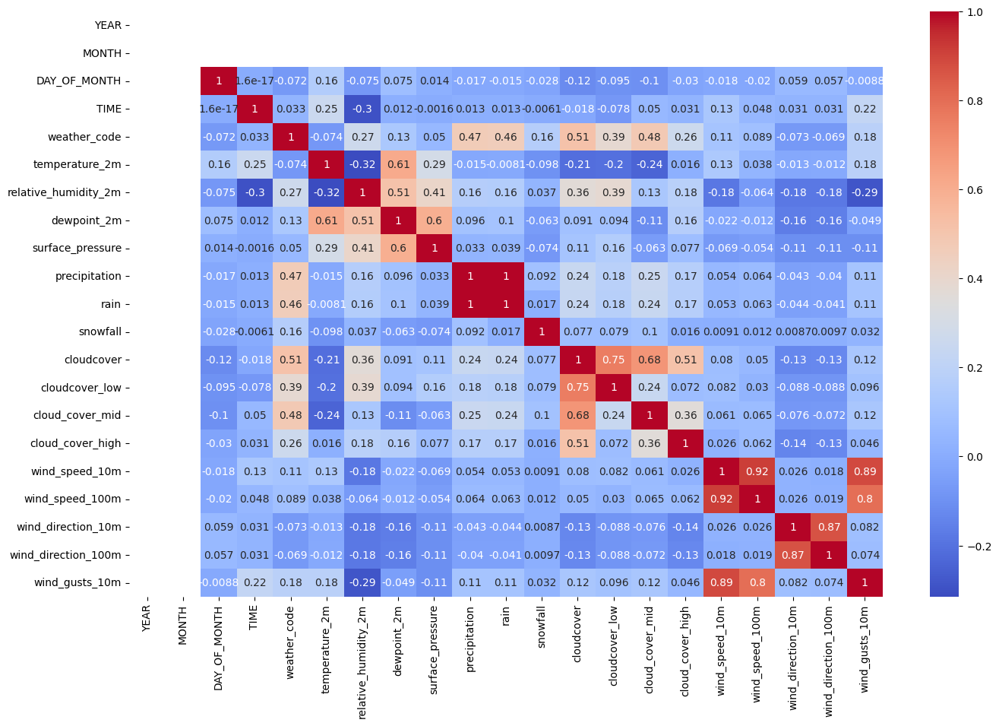

In [76]:
# correlation matrix
plt.figure(figsize=(16,10))
numerical_df = weather_df.select_dtypes(include=['number'])
correlation_matrix = numerical_df.corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')

## Merging Flight Data and Weather Data

In [11]:
# Create the 'IDENTITY' column by concatenating 'ORIGIN', 'DAY_OF_MONTH' and 'CRS_DEP_TIME_HH' with underscores
flight_df_new['IDENTITY'] = flight_df_new['ORIGIN'].astype(str) + '_' + \
                             flight_df_new['DAY_OF_MONTH'].astype(str) + '_' + \
                             flight_df_new['CRS_DEP_TIME_HH'].astype(str)
flight_df_new.head()

,YEAR,QUARTER,MONTH,DAY_OF_MONTH,DAY_OF_WEEK,MKT_UNIQUE_CARRIER,MKT_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN,ORIGIN_CITY_NAME,...,SECURITY_DELAY,LATE_AIRCRAFT_DELAY,CRS_DEP_TIME_HH,DEP_TIME_HH,CRS_ARR_TIME_HH,ARR_TIME_HH,CRS_DEP_TIME_OF_DAY,CRS_ARR_TIME_OF_DAY,ARR_DELAY_CLASS,IDENTITY
0,2024,2,5,1,3,AA,1,12478,JFK,"New York, NY",...,0.0,0.0,9,9,12,12,Afternoon,Evening,0,JFK_1_9
1,2024,2,5,1,3,AA,10,12892,LAX,"Los Angeles, CA",...,0.0,0.0,22,22,7,6,Night,Morning,0,LAX_1_22
2,2024,2,5,1,3,AA,1002,15919,XNA,"Fayetteville, AR",...,0.0,0.0,6,6,7,7,Morning,Afternoon,0,XNA_1_6
3,2024,2,5,1,3,AA,1003,11292,DEN,"Denver, CO",...,0.0,0.0,0,0,6,6,Night,Morning,0,DEN_1_0
4,2024,2,5,1,3,AA,1004,10721,BOS,"Boston, MA",...,0.0,0.0,8,7,10,10,Afternoon,Afternoon,0,BOS_1_8


In [12]:
# Create the 'IDENTITY' column by concatenating 'AIRPORT', 'DAY_OF_MONTH', and 'TIME' with underscores
weather_df['IDENTITY'] = weather_df['AIRPORT'].astype(str) + '_' + \
                           weather_df['DAY_OF_MONTH'].astype(str) + '_' + \
                           weather_df['TIME'].astype(str)

weather_df.drop(columns=['AIRPORT', 'YEAR', 'MONTH', 'DAY_OF_MONTH', 'TIME'], inplace=True)

weather_df.tail(10)

,weather_code,temperature_2m,relative_humidity_2m,dewpoint_2m,surface_pressure,precipitation,rain,snowfall,cloudcover,cloudcover_low,cloud_cover_mid,cloud_cover_high,wind_speed_10m,wind_speed_100m,wind_direction_10m,wind_direction_100m,wind_gusts_10m,IDENTITY
261878,0,38.6,12,3.8,999.1,0.0,0.0,0.0,0,0,0,0,12.8,16.3,170,172,33.8,YUM_31_14
261879,0,39.2,11,3.6,998.4,0.0,0.0,0.0,0,0,0,0,12.3,15.5,177,177,32.0,YUM_31_15
261880,0,39.4,10,2.6,997.8,0.0,0.0,0.0,0,0,0,0,13.0,16.6,182,181,30.6,YUM_31_16
261881,0,38.8,10,1.3,997.4,0.0,0.0,0.0,0,0,0,0,14.8,19.1,180,180,32.0,YUM_31_17
261882,0,37.5,8,-1.6,997.5,0.0,0.0,0.0,0,0,0,0,14.9,19.9,173,174,30.6,YUM_31_18
261883,0,35.2,9,-2.0,997.7,0.0,0.0,0.0,0,0,0,0,14.2,24.4,164,166,30.6,YUM_31_19
261884,0,32.1,11,-2.1,998.0,0.0,0.0,0.0,0,0,0,0,15.0,28.6,159,161,26.6,YUM_31_20
261885,0,30.2,14,-0.2,998.3,0.0,0.0,0.0,0,0,0,0,16.0,29.6,157,159,28.1,YUM_31_21
261886,0,28.5,21,4.0,998.6,0.0,0.0,0.0,0,0,0,0,16.2,30.4,159,159,28.8,YUM_31_22
261887,0,26.8,29,7.1,998.5,0.0,0.0,0.0,0,0,0,0,13.2,26.0,163,161,28.8,YUM_31_23


In [13]:
merged_df_origin = flight_df_new.merge(weather_df, on='IDENTITY', suffixes=('_ORIGIN', '_ORIGIN'))

In [14]:
#drop identity column
merged_df_origin.drop(columns=['IDENTITY'], inplace=True)

In [15]:
merged_df_origin['IDENTITY'] = merged_df_origin['DEST'].astype(str) + '_' + \
                             merged_df_origin['DAY_OF_MONTH'].astype(str) + '_' + \
                             merged_df_origin['CRS_ARR_TIME_HH'].astype(str)


In [16]:
merged_df_dest = merged_df_origin.merge(weather_df, on='IDENTITY', suffixes=('_ORIGIN', '_DEST'))

In [17]:
merged_df_dest.columns

Index(['YEAR', 'QUARTER', 'MONTH', 'DAY_OF_MONTH', 'DAY_OF_WEEK',
       'MKT_UNIQUE_CARRIER', 'MKT_CARRIER_FL_NUM', 'ORIGIN_AIRPORT_ID',
       'ORIGIN', 'ORIGIN_CITY_NAME', 'ORIGIN_STATE_ABR', 'DEST_AIRPORT_ID',
       'DEST', 'DEST_CITY_NAME', 'DEST_STATE_ABR', 'CRS_DEP_TIME', 'DEP_TIME',
       'DEP_DELAY', 'DEP_DELAY_NEW', 'TAXI_OUT', 'TAXI_IN', 'CRS_ARR_TIME',
       'ARR_TIME', 'ARR_DELAY', 'ARR_DELAY_NEW', 'CRS_ELAPSED_TIME',
       'ACTUAL_ELAPSED_TIME', 'AIR_TIME', 'DISTANCE', 'CARRIER_DELAY',
       'WEATHER_DELAY', 'NAS_DELAY', 'SECURITY_DELAY', 'LATE_AIRCRAFT_DELAY',
       'CRS_DEP_TIME_HH', 'DEP_TIME_HH', 'CRS_ARR_TIME_HH', 'ARR_TIME_HH',
       'CRS_DEP_TIME_OF_DAY', 'CRS_ARR_TIME_OF_DAY', 'ARR_DELAY_CLASS',
       'weather_code_ORIGIN', 'temperature_2m_ORIGIN',
       'relative_humidity_2m_ORIGIN', 'dewpoint_2m_ORIGIN',
       'surface_pressure_ORIGIN', 'precipitation_ORIGIN', 'rain_ORIGIN',
       'snowfall_ORIGIN', 'cloudcover_ORIGIN', 'cloudcover_low_ORIGIN',
      

In [18]:
merged_df_dest.drop(columns=['IDENTITY', 'CRS_DEP_TIME_HH', 'DEP_TIME_HH', 'CRS_ARR_TIME_HH', 'ARR_TIME_HH'], inplace=True)

In [19]:
#make copy of merged_df_dest
merged_df = merged_df_dest.copy()


In [20]:
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 627520 entries, 0 to 627519
Data columns (total 71 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   YEAR                         627520 non-null  int64  
 1   QUARTER                      627520 non-null  int64  
 2   MONTH                        627520 non-null  int64  
 3   DAY_OF_MONTH                 627520 non-null  int64  
 4   DAY_OF_WEEK                  627520 non-null  int64  
 5   MKT_UNIQUE_CARRIER           627520 non-null  object 
 6   MKT_CARRIER_FL_NUM           627520 non-null  int64  
 7   ORIGIN_AIRPORT_ID            627520 non-null  int64  
 8   ORIGIN                       627520 non-null  object 
 9   ORIGIN_CITY_NAME             627520 non-null  object 
 10  ORIGIN_STATE_ABR             627520 non-null  object 
 11  DEST_AIRPORT_ID              627520 non-null  int64  
 12  DEST                         627520 non-null  object 
 13 

In [21]:
merged_df.head()

,YEAR,QUARTER,MONTH,DAY_OF_MONTH,DAY_OF_WEEK,MKT_UNIQUE_CARRIER,MKT_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN,ORIGIN_CITY_NAME,...,snowfall_DEST,cloudcover_DEST,cloudcover_low_DEST,cloud_cover_mid_DEST,cloud_cover_high_DEST,wind_speed_10m_DEST,wind_speed_100m_DEST,wind_direction_10m_DEST,wind_direction_100m_DEST,wind_gusts_10m_DEST
0,2024,2,5,1,3,AA,1,12478,JFK,"New York, NY",...,0.0,21,23,1,0,19.3,20.7,243,239,36.0
1,2024,2,5,1,3,B6,523,12478,JFK,"New York, NY",...,0.0,21,23,1,0,19.3,20.7,243,239,36.0
2,2024,2,5,1,3,UA,1013,11292,DEN,"Denver, CO",...,0.0,21,23,1,0,19.3,20.7,243,239,36.0
3,2024,2,5,1,3,AA,1711,11298,DFW,"Dallas/Fort Worth, TX",...,0.0,21,23,1,0,19.3,20.7,243,239,36.0
4,2024,2,5,1,3,AA,1526,13303,MIA,"Miami, FL",...,0.0,21,23,1,0,19.3,20.7,243,239,36.0


In [22]:
# Function to convert time from "hhmm" format to total minutes
def convert_to_minutes(time_value):
    if pd.isna(time_value):
        return None
    hours = time_value // 100
    minutes = time_value % 100
    return hours * 60 + minutes

time_columns = ['CRS_DEP_TIME', 'DEP_TIME', 'CRS_ARR_TIME', 'ARR_TIME']
for col in time_columns:
    merged_df[col] = merged_df[col].apply(convert_to_minutes)
merged_df[time_columns] = merged_df[time_columns].astype(int)

In [23]:
merged_df[time_columns].head()

,CRS_DEP_TIME,DEP_TIME,CRS_ARR_TIME,ARR_TIME
0,540,540,749,723
1,580,576,768,785
2,675,711,767,800
3,635,630,722,714
4,602,747,771,906


# **Exploratory Data Analysis**

## Visualizations

### Arrival Delay Distribution

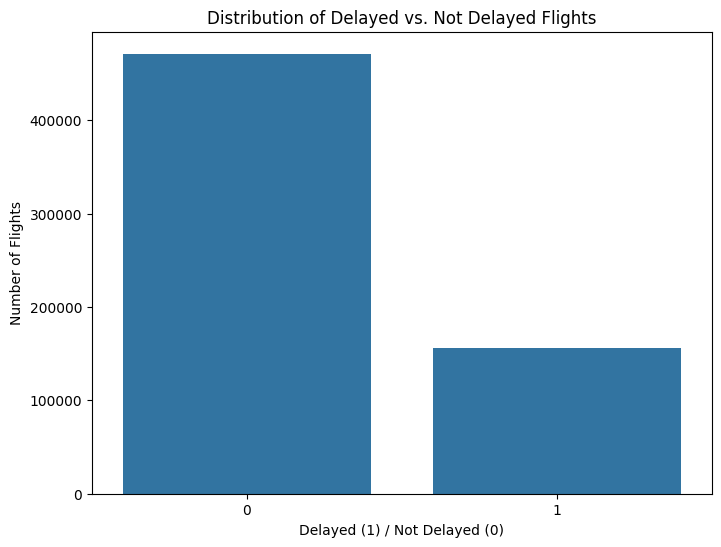

In [98]:
plt.figure(figsize=(8,6))
sns.countplot(x='ARR_DELAY_CLASS', data=merged_df)
plt.title('Distribution of Delayed vs. Not Delayed Flights')
plt.xlabel('Delayed (1) / Not Delayed (0)')
plt.ylabel('Number of Flights')
plt.show()

### Departure Delay vs Arrival Delay

<Axes: xlabel='DEP_DELAY_NEW', ylabel='ARR_DELAY_NEW'>

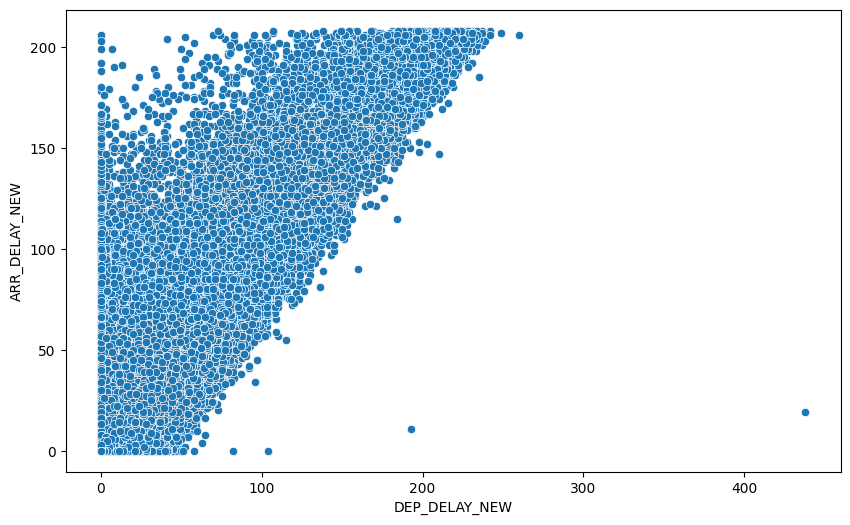

In [99]:
plt.figure(figsize=(10,6))
sns.scatterplot(x='DEP_DELAY_NEW', y='ARR_DELAY_NEW', data=merged_df)

### Day of the Week vs Arrival Delay



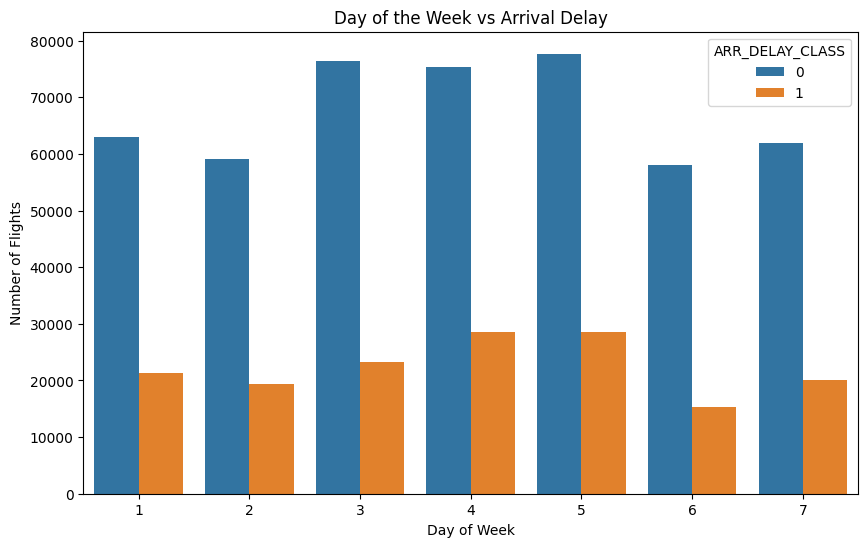

In [100]:
plt.figure(figsize=(10,6))
sns.countplot(data=merged_df, x='DAY_OF_WEEK', hue='ARR_DELAY_CLASS')

plt.title('Day of the Week vs Arrival Delay')
plt.xlabel('Day of Week')
plt.ylabel('Number of Flights')
plt.show()

### Scheduled Arrival Time of Day vs Arrival Delay

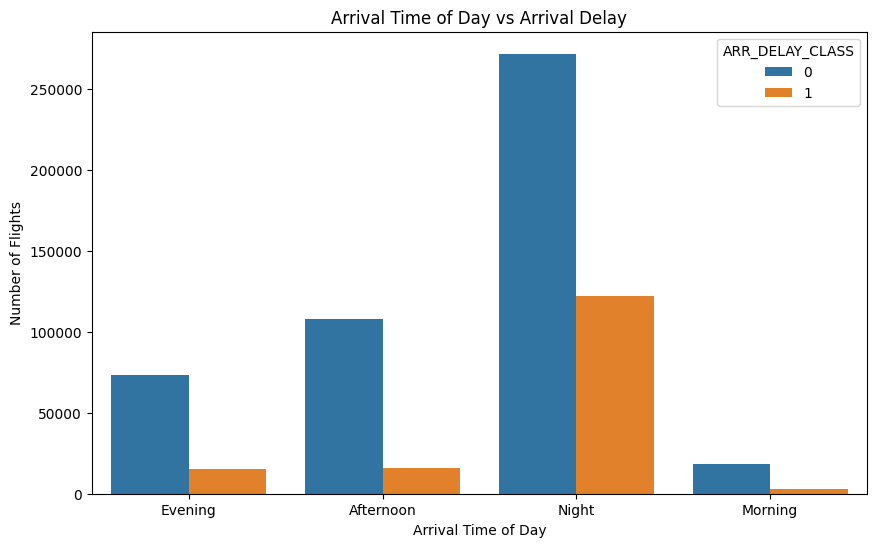

In [101]:
plt.figure(figsize=(10,6))
sns.countplot(data=merged_df, x='CRS_ARR_TIME_OF_DAY', hue='ARR_DELAY_CLASS')

plt.title('Arrival Time of Day vs Arrival Delay')
plt.xlabel('Arrival Time of Day')
plt.ylabel('Number of Flights')
plt.show()


### Scheduled Departure Time of Day vs Arrival Delay

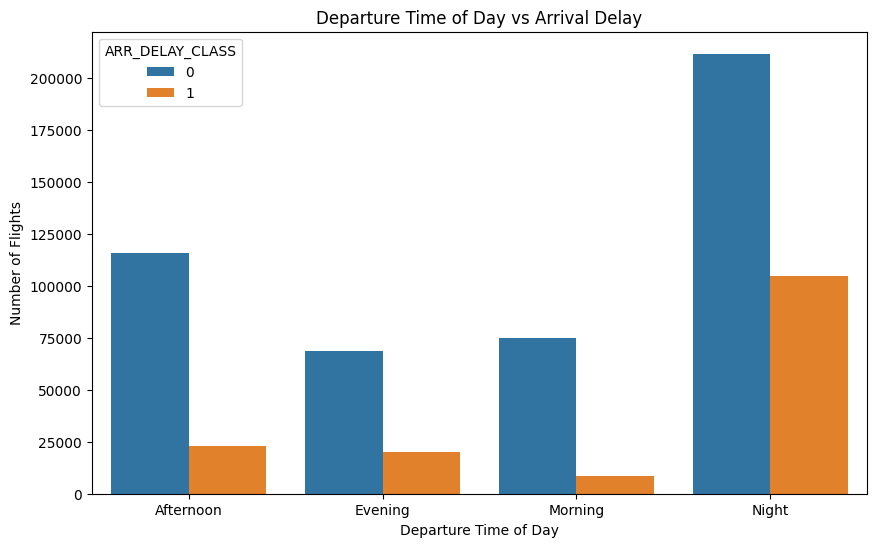

In [102]:
plt.figure(figsize=(10,6))
sns.countplot(data=merged_df, x='CRS_DEP_TIME_OF_DAY', hue='ARR_DELAY_CLASS')

plt.title('Departure Time of Day vs Arrival Delay')
plt.xlabel('Departure Time of Day')
plt.ylabel('Number of Flights')
plt.show()


### Time of day most flights arrive

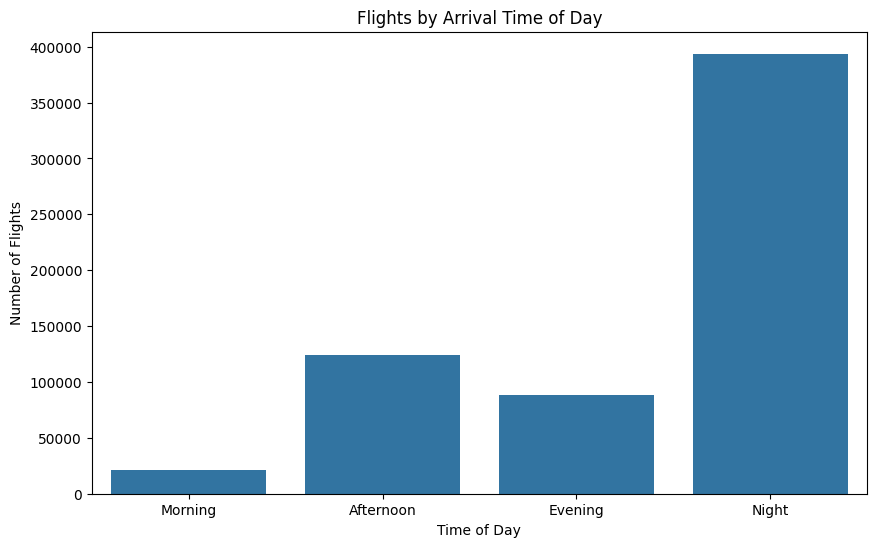

In [103]:
plt.figure(figsize=(10,6))
sns.countplot(data=merged_df, x='CRS_ARR_TIME_OF_DAY', order=['Morning', 'Afternoon', 'Evening', 'Night'])
plt.title('Flights by Arrival Time of Day')
plt.xlabel('Time of Day')
plt.ylabel('Number of Flights')
plt.show()

### Carrier Performance

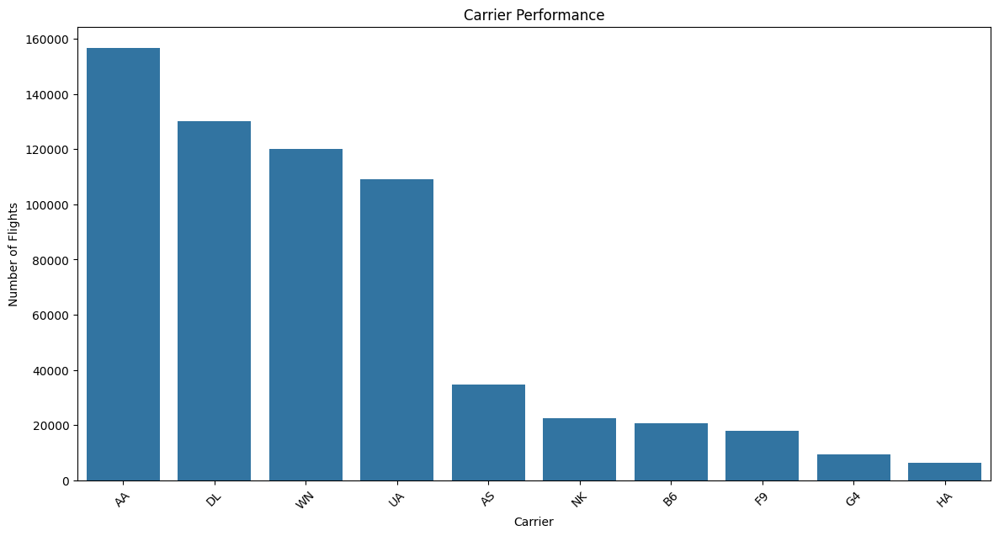

In [104]:
plt.figure(figsize=(14,7))
sns.countplot(data=merged_df, x='MKT_UNIQUE_CARRIER', order=merged_df['MKT_UNIQUE_CARRIER'].value_counts().index)

plt.title('Carrier Performance')
plt.xlabel('Carrier')
plt.ylabel('Number of Flights')
plt.xticks(rotation=45)
plt.show()

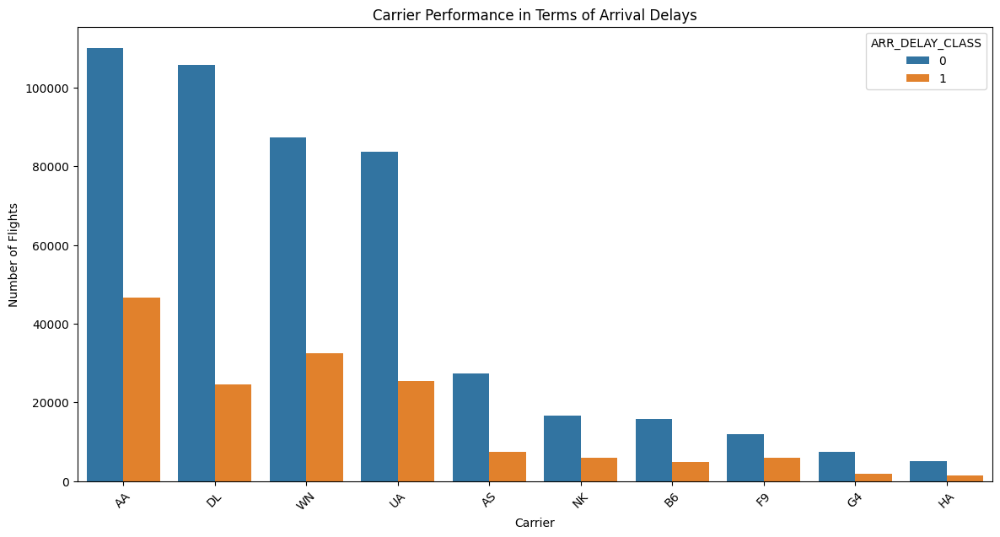

In [105]:
plt.figure(figsize=(14,7))
sns.countplot(data=merged_df, x='MKT_UNIQUE_CARRIER', hue='ARR_DELAY_CLASS', order=merged_df['MKT_UNIQUE_CARRIER'].value_counts().index)

plt.title('Carrier Performance in Terms of Arrival Delays')
plt.xlabel('Carrier')
plt.ylabel('Number of Flights')
plt.xticks(rotation=45)
plt.show()

### Flight Distance

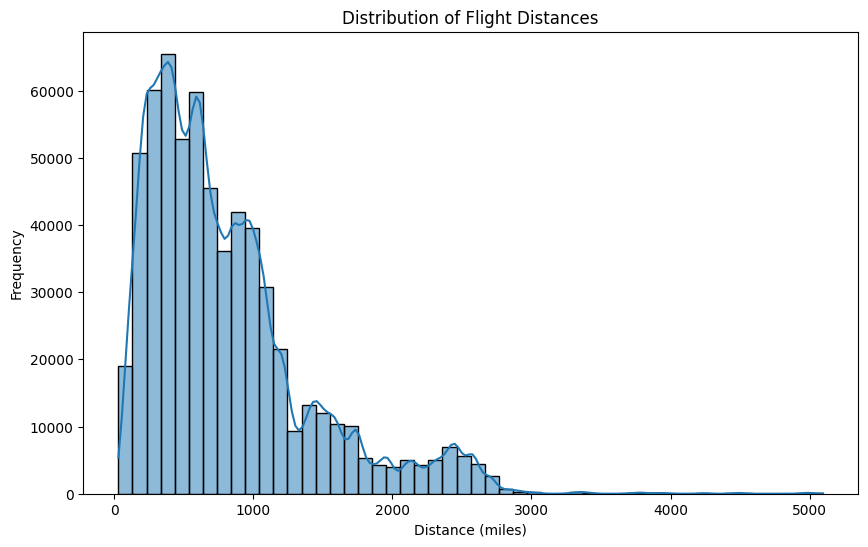

In [106]:
plt.figure(figsize=(10,6))
sns.histplot(merged_df['DISTANCE'], bins=50, kde=True)
plt.title('Distribution of Flight Distances')
plt.xlabel('Distance (miles)')
plt.ylabel('Frequency')
plt.show()


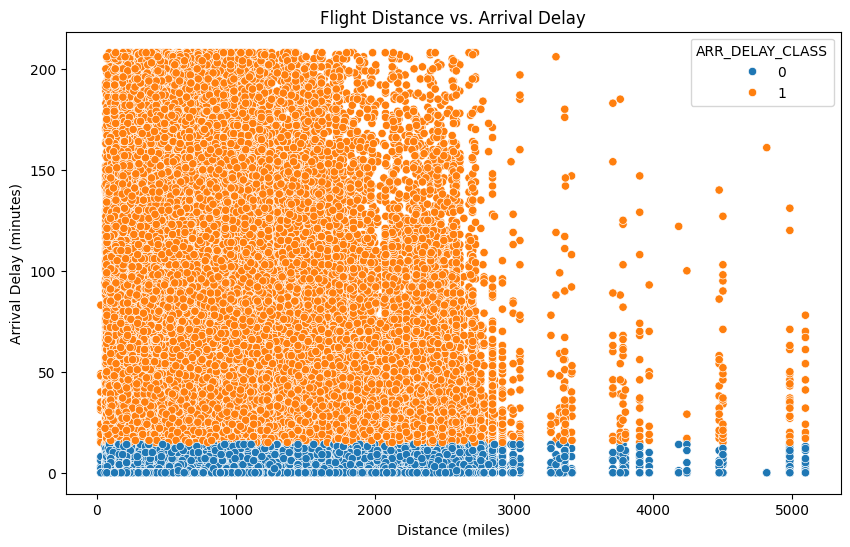

In [107]:
plt.figure(figsize=(10,6))
sns.scatterplot(x='DISTANCE', y='ARR_DELAY_NEW', hue='ARR_DELAY_CLASS', data=merged_df)
plt.title('Flight Distance vs. Arrival Delay')
plt.xlabel('Distance (miles)')
plt.ylabel('Arrival Delay (minutes)')
plt.show()

###  Correlation between Scheduled Elapsed Time and Distance

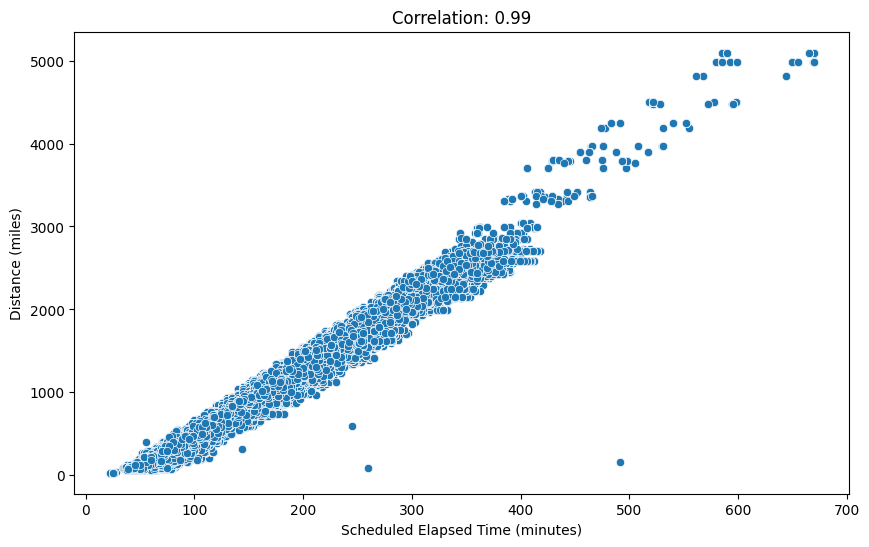

Correlation between CRS_ELAPSED_TIME and DISTANCE: 0.9874207915135832


In [108]:
correlation = merged_df['CRS_ELAPSED_TIME'].corr(merged_df['DISTANCE'])

plt.figure(figsize=(10,6))
sns.scatterplot(x='CRS_ELAPSED_TIME', y='DISTANCE', data=merged_df)
plt.title(f'Correlation: {correlation:.2f}')
plt.xlabel('Scheduled Elapsed Time (minutes)')
plt.ylabel('Distance (miles)')
plt.show()

print(f"Correlation between CRS_ELAPSED_TIME and DISTANCE: {correlation}")

### Number of Flights for each Delay Cause

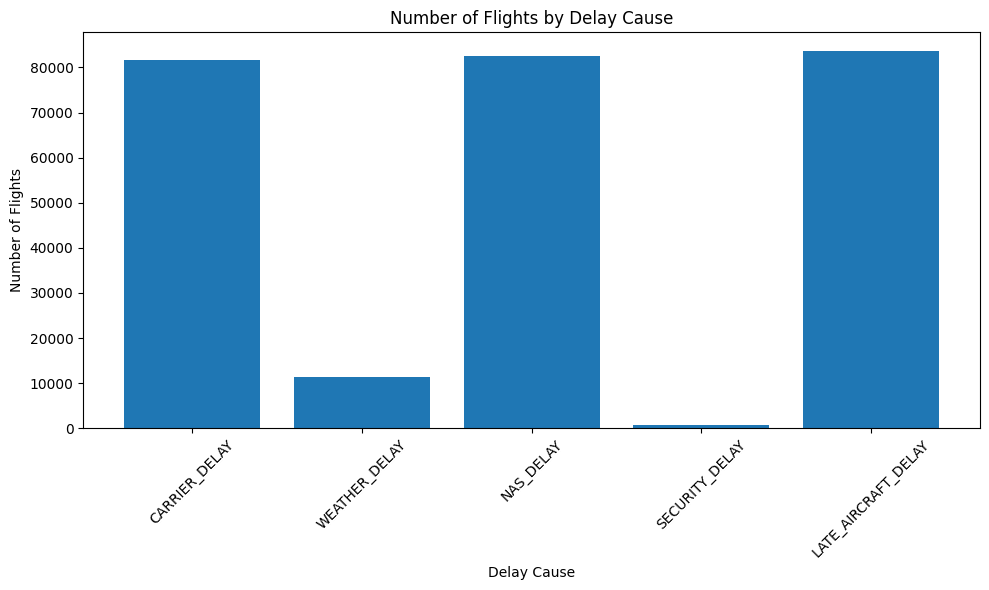

In [109]:
# Creating a dictionary to store the number of flights with each type of delay
delay_causes = ['CARRIER_DELAY', 'WEATHER_DELAY', 'NAS_DELAY', 'SECURITY_DELAY', 'LATE_AIRCRAFT_DELAY']
delay_counts = {cause: (merged_df[cause] > 0).sum() for cause in delay_causes}

plt.figure(figsize=(10, 6))
plt.bar(delay_counts.keys(), delay_counts.values())
plt.title('Number of Flights by Delay Cause')
plt.xlabel('Delay Cause')
plt.ylabel('Number of Flights')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

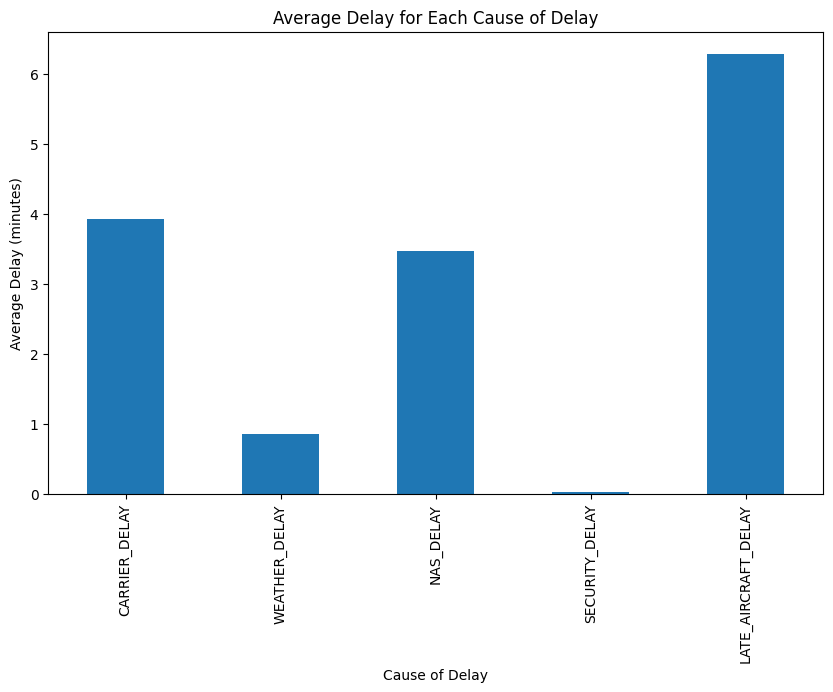

In [110]:
delay_causes = ['CARRIER_DELAY', 'WEATHER_DELAY', 'NAS_DELAY', 'SECURITY_DELAY', 'LATE_AIRCRAFT_DELAY']
average_delays = merged_df[delay_causes].mean()

plt.figure(figsize=(10,6))
average_delays.plot(kind='bar')
plt.title('Average Delay for Each Cause of Delay')
plt.xlabel('Cause of Delay')
plt.ylabel('Average Delay (minutes)')
plt.show()

## Correlation Matrix

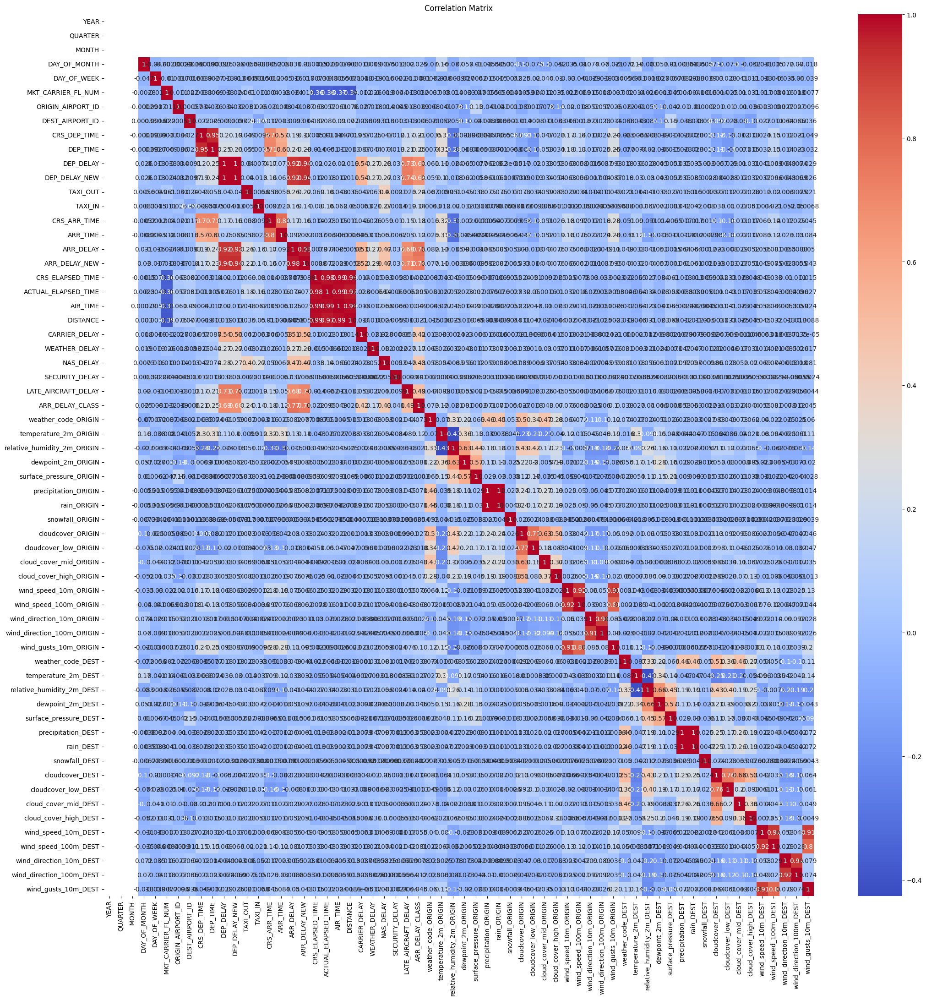

In [111]:
plt.figure(figsize=(25,25))
numerical_df = merged_df.select_dtypes(include=['number'])
correlation_matrix = numerical_df.corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix')
plt.show()


## Directed Graph
Creating a directed graph with "ORIGIN" & "DEST" as nodes and "CRS_ELAPSED_TIME" as edge weight

In [24]:
graph = nx.DiGraph()

# Creating a subset of the columns (ORIGIN, DEST, CRS_ELAPSED_TIME) and drop duplicates for (ORIGIN, DEST) pairs
graph_data = merged_df[['ORIGIN', 'DEST', 'CRS_ELAPSED_TIME']].drop_duplicates(subset=['ORIGIN', 'DEST'])

# Adding edges to the graph, using ORIGIN and DEST as nodes and CRS_ELAPSED_TIME as edge weight
for _, row in graph_data.iterrows():
    origin = row['ORIGIN']
    dest = row['DEST']
    elapsed_time = row['CRS_ELAPSED_TIME']
    graph.add_edge(origin, dest, weight=elapsed_time)

# Output the number of nodes and edges as a verification
graph.number_of_nodes(), graph.number_of_edges()

(352, 6052)

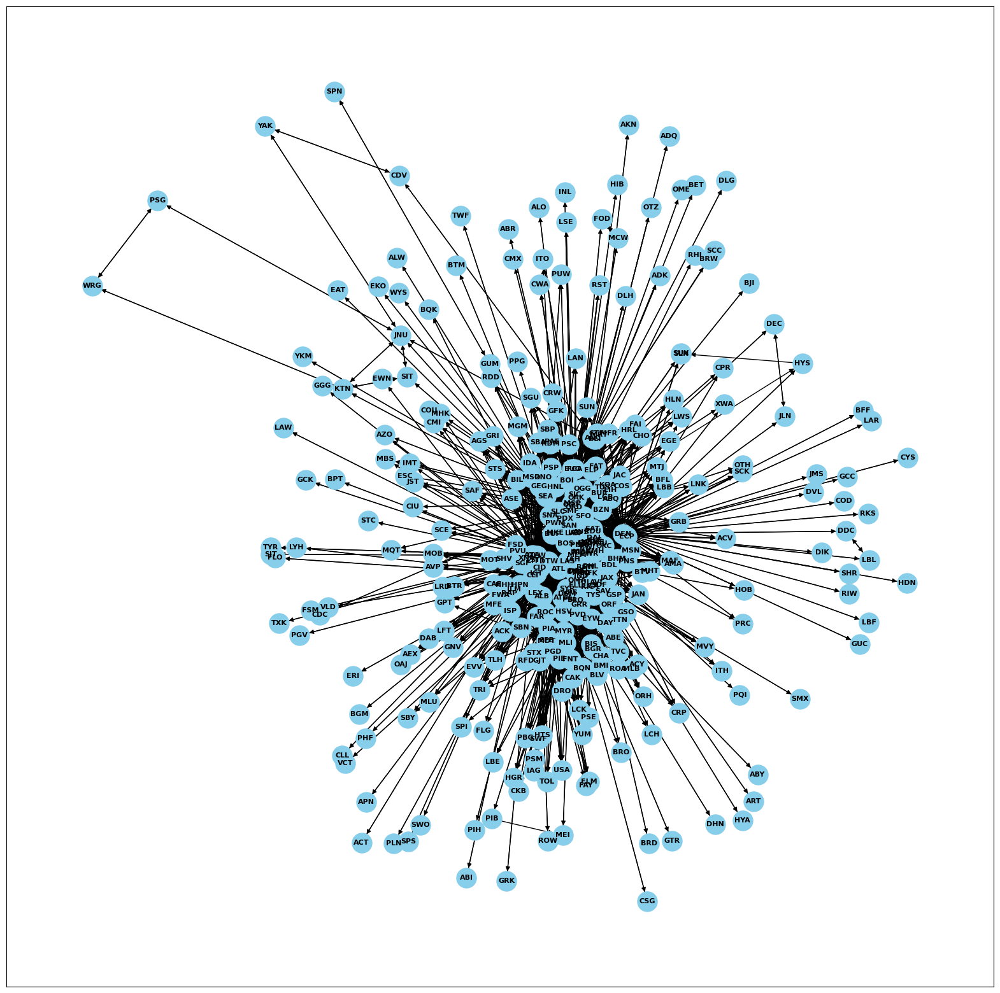

In [116]:
pos = nx.spring_layout(graph)

# use nx.draw_networkx to show graph
plt.figure(figsize=(20, 20))
nx.draw_networkx(graph, pos, with_labels=True, node_size=500, node_color='skyblue', font_size=8, font_color='black', font_weight='bold')
plt.show()

### In-Degree Centrality

The percentage of flights coming to a particular node (Airport)

In [25]:
in_degree_centrality = nx.in_degree_centrality(graph)

# Display the in-degree centrality for each node
# for node, centrality in in_degree_centrality.items():
#     print(f"{node}: {centrality}")
in_degree_df = pd.DataFrame(list(in_degree_centrality.items()), columns=['Node', 'In-Degree Centrality'])
in_degree_df = in_degree_df.sort_values(by='In-Degree Centrality', ascending=False)

in_degree_df.head(10)

,Node,In-Degree Centrality
3,DFW,0.501425
2,DEN,0.487179
7,ORD,0.450142
19,ATL,0.415954
24,CLT,0.378917
9,LAS,0.347578
61,IAH,0.304843
46,MSP,0.301994
6,PHX,0.284900
5,DCA,0.282051


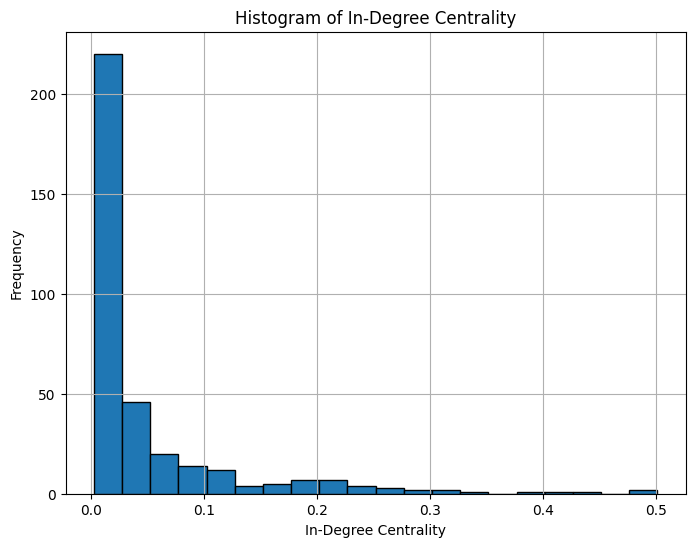

In [26]:
# Extracting the centrality values
centrality_values = list(in_degree_centrality.values())

plt.figure(figsize=(8, 6))
plt.hist(centrality_values, bins=20, edgecolor='black')
plt.title('Histogram of In-Degree Centrality')
plt.xlabel('In-Degree Centrality')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

### Out-Degree Centrality
The percentage of flights moving from a particular node (Airport)

In [27]:
out_degree_centrality = nx.out_degree_centrality(graph)

out_degree_df = pd.DataFrame(list(out_degree_centrality.items()), columns=['Node', 'Out-Degree Centrality'])
out_degree_df = out_degree_df.sort_values(by='Out-Degree Centrality', ascending=False)

out_degree_df.head(10)

,Node,Out-Degree Centrality
3,DFW,0.501425
2,DEN,0.487179
7,ORD,0.450142
19,ATL,0.415954
24,CLT,0.378917
9,LAS,0.350427
61,IAH,0.304843
46,MSP,0.301994
6,PHX,0.284900
5,DCA,0.282051


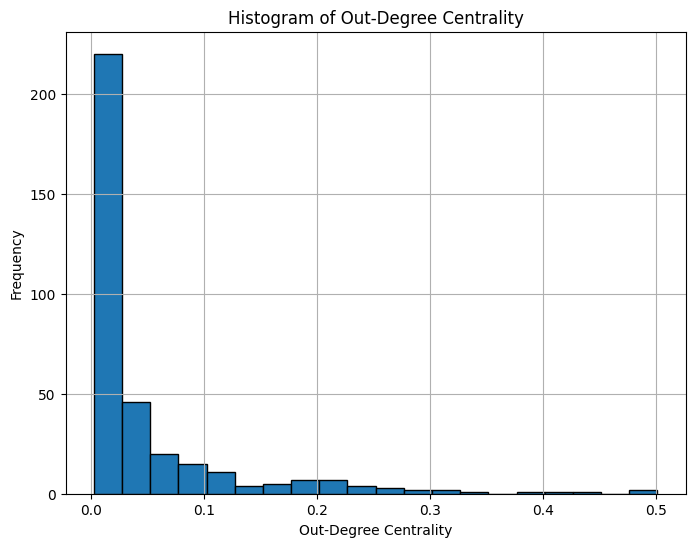

In [28]:
out_centrality_values = list(out_degree_centrality.values())

plt.figure(figsize=(8, 6))
plt.hist(out_centrality_values, bins=20, edgecolor='black')
plt.title('Histogram of Out-Degree Centrality')
plt.xlabel('Out-Degree Centrality')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

### Betweenness Centrality
analyzing how often a node lies on the shortest paths between other nodes. It quantifies the degree to which a node acts as an intermediary

In [29]:
betweenness_centrality = nx.betweenness_centrality(graph)

betweenness_centrality_df = pd.DataFrame(list(betweenness_centrality.items()), columns=['Node', 'Betweenness Centrality'])
betweenness_centrality_df = betweenness_centrality_df.sort_values(by='Betweenness Centrality', ascending=False)

betweenness_centrality_df.head(10)

,Node,Betweenness Centrality
2,DEN,0.174739
3,DFW,0.173562
7,ORD,0.120712
19,ATL,0.087288
24,CLT,0.075395
46,MSP,0.067109
16,SEA,0.063089
64,ANC,0.062191
9,LAS,0.045837
28,SLC,0.045239


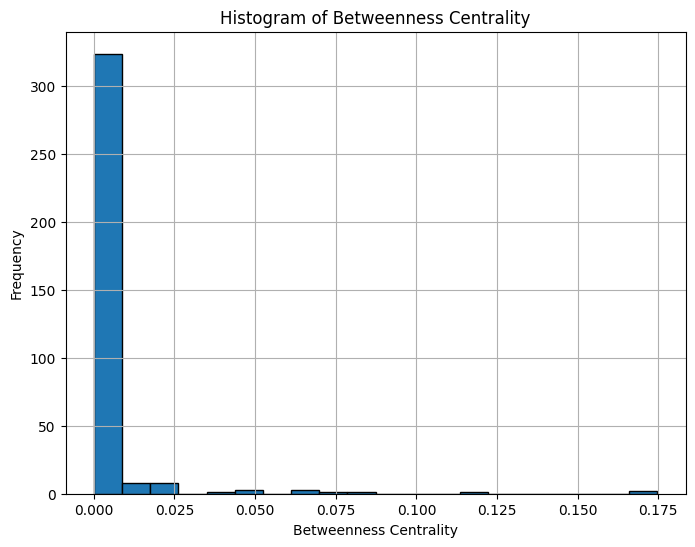

In [30]:
betweenness_centrality_values = list(betweenness_centrality.values())

plt.figure(figsize=(8, 6))
plt.hist(betweenness_centrality_values, bins=20, edgecolor='black')
plt.title('Histogram of Betweenness Centrality')
plt.xlabel('Betweenness Centrality')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

### Closeness Centrality
represents how “close” a node is to all other nodes in the network. A higher closeness centrality score indicates that a node is more central, meaning it has shorter average distances to all other nodes. That node / airport is directly connected or “just a hop away” from most others in the network.

In [31]:
closeness_centrality = nx.closeness_centrality(graph)

closeness_centrality_df = pd.DataFrame(list(closeness_centrality.items()), columns=['Node', 'Closeness Centrality'])
closeness_centrality_df = closeness_centrality_df.sort_values(by='Closeness Centrality', ascending=False)

closeness_centrality_df.head(10)

,Node,Closeness Centrality
3,DFW,0.657303
2,DEN,0.651206
7,ORD,0.635870
19,ATL,0.622340
9,LAS,0.593909
24,CLT,0.593909
46,MSP,0.582090
61,IAH,0.579208
6,PHX,0.572594
16,SEA,0.568882


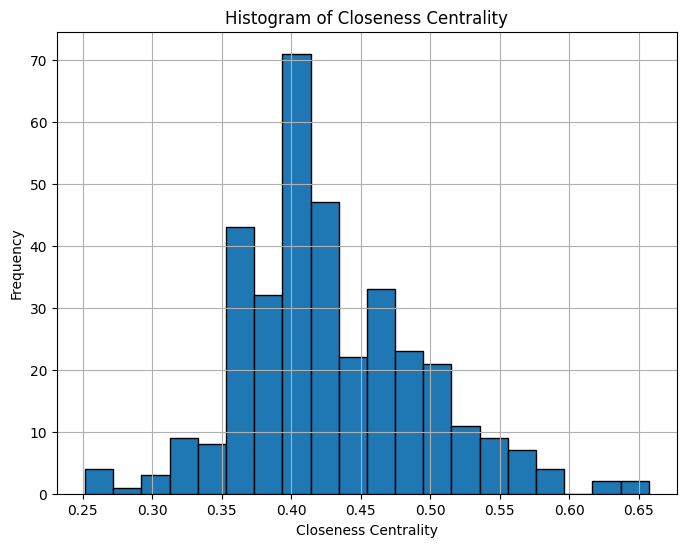

In [32]:
closeness_centrality_values = list(closeness_centrality.values())

plt.figure(figsize=(8, 6))
plt.hist(closeness_centrality_values, bins=20, edgecolor='black')
plt.title('Histogram of Closeness Centrality')
plt.xlabel('Closeness Centrality')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

### Correlation Matrix of Centrality Measures

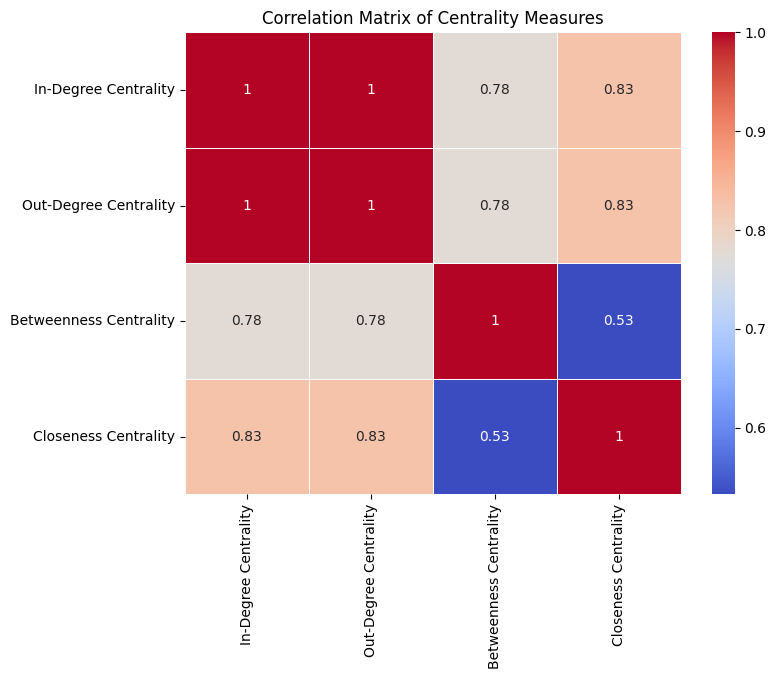

In [33]:
# Combining all centrality measures into a DataFrame
centrality_data = pd.DataFrame({
    'In-Degree Centrality': in_degree_centrality,
    'Out-Degree Centrality': out_degree_centrality,
    'Betweenness Centrality': betweenness_centrality,
    'Closeness Centrality': closeness_centrality
})

correlation_matrix = centrality_data.corr()

plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Matrix of Centrality Measures')
plt.show()

In [34]:
centrality_data

,In-Degree Centrality,Out-Degree Centrality,Betweenness Centrality,Closeness Centrality
JFK,0.188034,0.188034,1.821145e-02,0.532625
LAX,0.262108,0.262108,1.775394e-02,0.565217
DEN,0.487179,0.487179,1.747393e-01,0.651206
DFW,0.501425,0.501425,1.735623e-01,0.657303
MIA,0.202279,0.202279,4.195839e-03,0.533435
...,...,...,...,...
STC,0.002849,0.002849,0.000000e+00,0.288414
WYS,0.002849,0.002849,0.000000e+00,0.358163
ACK,0.019943,0.019943,1.165076e-05,0.400685
MVY,0.008547,0.008547,9.168181e-07,0.369863


### Merging Centrality Data with Dataframe

In [35]:
# merge centrality_data with data_cleaned with on "ORIGIN" feature.
centrality_data_origin = centrality_data.copy()
centrality_data_origin.index.name = 'ORIGIN'
centrality_data_origin.reset_index(inplace=True)

centrality_data_origin.head()


,ORIGIN,In-Degree Centrality,Out-Degree Centrality,Betweenness Centrality,Closeness Centrality
0,JFK,0.188034,0.188034,0.018211,0.532625
1,LAX,0.262108,0.262108,0.017754,0.565217
2,DEN,0.487179,0.487179,0.174739,0.651206
3,DFW,0.501425,0.501425,0.173562,0.657303
4,MIA,0.202279,0.202279,0.004196,0.533435


In [36]:
data_new_origin = merged_df.merge(centrality_data_origin, on='ORIGIN', suffixes=('_ORIGIN', '_ORIGIN'))
data_new_origin

,YEAR,QUARTER,MONTH,DAY_OF_MONTH,DAY_OF_WEEK,MKT_UNIQUE_CARRIER,MKT_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN,ORIGIN_CITY_NAME,...,cloud_cover_high_DEST,wind_speed_10m_DEST,wind_speed_100m_DEST,wind_direction_10m_DEST,wind_direction_100m_DEST,wind_gusts_10m_DEST,In-Degree Centrality,Out-Degree Centrality,Betweenness Centrality,Closeness Centrality
0,2024,2,5,1,3,AA,1,12478,JFK,"New York, NY",...,0,19.3,20.7,243,239,36.0,0.188034,0.188034,0.018211,0.532625
1,2024,2,5,1,3,B6,523,12478,JFK,"New York, NY",...,0,19.3,20.7,243,239,36.0,0.188034,0.188034,0.018211,0.532625
2,2024,2,5,1,3,B6,323,12478,JFK,"New York, NY",...,0,19.3,20.7,243,239,36.0,0.188034,0.188034,0.018211,0.532625
3,2024,2,5,1,3,AA,2646,12478,JFK,"New York, NY",...,0,11.6,13.7,202,203,25.2,0.188034,0.188034,0.018211,0.532625
4,2024,2,5,1,3,AA,2819,12478,JFK,"New York, NY",...,0,22.0,31.0,266,267,44.3,0.188034,0.188034,0.018211,0.532625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
627515,2024,2,5,27,1,B6,1963,12250,HYA,"Hyannis, MA",...,100,28.7,40.1,160,162,50.4,0.002849,0.002849,0.000000,0.347869
627516,2024,2,5,28,2,B6,1963,12250,HYA,"Hyannis, MA",...,0,25.5,33.8,247,251,46.1,0.002849,0.002849,0.000000,0.347869
627517,2024,2,5,29,3,B6,1963,12250,HYA,"Hyannis, MA",...,0,8.7,10.5,228,243,23.8,0.002849,0.002849,0.000000,0.347869
627518,2024,2,5,30,4,B6,1963,12250,HYA,"Hyannis, MA",...,0,17.1,21.9,352,351,37.1,0.002849,0.002849,0.000000,0.347869


In [37]:
# merge centrality_data with data_cleaned with on "DEST" feature.
centrality_data_dest = centrality_data.copy()
centrality_data_dest.index.name = 'DEST'
centrality_data_dest.reset_index(inplace=True)

centrality_data_dest.head()

,DEST,In-Degree Centrality,Out-Degree Centrality,Betweenness Centrality,Closeness Centrality
0,JFK,0.188034,0.188034,0.018211,0.532625
1,LAX,0.262108,0.262108,0.017754,0.565217
2,DEN,0.487179,0.487179,0.174739,0.651206
3,DFW,0.501425,0.501425,0.173562,0.657303
4,MIA,0.202279,0.202279,0.004196,0.533435


In [38]:
data_new_dest = data_new_origin.merge(centrality_data_dest, on='DEST', suffixes=('_ORIGIN', '_DEST'))
data_new_dest

,YEAR,QUARTER,MONTH,DAY_OF_MONTH,DAY_OF_WEEK,MKT_UNIQUE_CARRIER,MKT_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN,ORIGIN_CITY_NAME,...,wind_direction_100m_DEST,wind_gusts_10m_DEST,In-Degree Centrality_ORIGIN,Out-Degree Centrality_ORIGIN,Betweenness Centrality_ORIGIN,Closeness Centrality_ORIGIN,In-Degree Centrality_DEST,Out-Degree Centrality_DEST,Betweenness Centrality_DEST,Closeness Centrality_DEST
0,2024,2,5,1,3,AA,1,12478,JFK,"New York, NY",...,239,36.0,0.188034,0.188034,0.018211,0.532625,0.262108,0.262108,0.017754,0.565217
1,2024,2,5,1,3,B6,523,12478,JFK,"New York, NY",...,239,36.0,0.188034,0.188034,0.018211,0.532625,0.262108,0.262108,0.017754,0.565217
2,2024,2,5,1,3,B6,323,12478,JFK,"New York, NY",...,239,36.0,0.188034,0.188034,0.018211,0.532625,0.262108,0.262108,0.017754,0.565217
3,2024,2,5,1,3,DL,685,12478,JFK,"New York, NY",...,249,41.0,0.188034,0.188034,0.018211,0.532625,0.262108,0.262108,0.017754,0.565217
4,2024,2,5,1,3,DL,482,12478,JFK,"New York, NY",...,235,32.0,0.188034,0.188034,0.018211,0.532625,0.262108,0.262108,0.017754,0.565217
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
627515,2024,2,5,27,1,UA,174,12016,GUM,"Guam, TT",...,82,43.2,0.005698,0.005698,0.005698,0.335885,0.002849,0.002849,0.000000,0.251613
627516,2024,2,5,28,2,UA,174,12016,GUM,"Guam, TT",...,93,34.9,0.005698,0.005698,0.005698,0.335885,0.002849,0.002849,0.000000,0.251613
627517,2024,2,5,29,3,UA,174,12016,GUM,"Guam, TT",...,95,32.4,0.005698,0.005698,0.005698,0.335885,0.002849,0.002849,0.000000,0.251613
627518,2024,2,5,30,4,UA,174,12016,GUM,"Guam, TT",...,82,39.2,0.005698,0.005698,0.005698,0.335885,0.002849,0.002849,0.000000,0.251613


In [39]:
data_new_dest.columns

Index(['YEAR', 'QUARTER', 'MONTH', 'DAY_OF_MONTH', 'DAY_OF_WEEK',
       'MKT_UNIQUE_CARRIER', 'MKT_CARRIER_FL_NUM', 'ORIGIN_AIRPORT_ID',
       'ORIGIN', 'ORIGIN_CITY_NAME', 'ORIGIN_STATE_ABR', 'DEST_AIRPORT_ID',
       'DEST', 'DEST_CITY_NAME', 'DEST_STATE_ABR', 'CRS_DEP_TIME', 'DEP_TIME',
       'DEP_DELAY', 'DEP_DELAY_NEW', 'TAXI_OUT', 'TAXI_IN', 'CRS_ARR_TIME',
       'ARR_TIME', 'ARR_DELAY', 'ARR_DELAY_NEW', 'CRS_ELAPSED_TIME',
       'ACTUAL_ELAPSED_TIME', 'AIR_TIME', 'DISTANCE', 'CARRIER_DELAY',
       'WEATHER_DELAY', 'NAS_DELAY', 'SECURITY_DELAY', 'LATE_AIRCRAFT_DELAY',
       'CRS_DEP_TIME_OF_DAY', 'CRS_ARR_TIME_OF_DAY', 'ARR_DELAY_CLASS',
       'weather_code_ORIGIN', 'temperature_2m_ORIGIN',
       'relative_humidity_2m_ORIGIN', 'dewpoint_2m_ORIGIN',
       'surface_pressure_ORIGIN', 'precipitation_ORIGIN', 'rain_ORIGIN',
       'snowfall_ORIGIN', 'cloudcover_ORIGIN', 'cloudcover_low_ORIGIN',
       'cloud_cover_mid_ORIGIN', 'cloud_cover_high_ORIGIN',
       'wind_speed_10

In [40]:
data_new = data_new_dest.copy()

In [41]:
data_new

,YEAR,QUARTER,MONTH,DAY_OF_MONTH,DAY_OF_WEEK,MKT_UNIQUE_CARRIER,MKT_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN,ORIGIN_CITY_NAME,...,wind_direction_100m_DEST,wind_gusts_10m_DEST,In-Degree Centrality_ORIGIN,Out-Degree Centrality_ORIGIN,Betweenness Centrality_ORIGIN,Closeness Centrality_ORIGIN,In-Degree Centrality_DEST,Out-Degree Centrality_DEST,Betweenness Centrality_DEST,Closeness Centrality_DEST
0,2024,2,5,1,3,AA,1,12478,JFK,"New York, NY",...,239,36.0,0.188034,0.188034,0.018211,0.532625,0.262108,0.262108,0.017754,0.565217
1,2024,2,5,1,3,B6,523,12478,JFK,"New York, NY",...,239,36.0,0.188034,0.188034,0.018211,0.532625,0.262108,0.262108,0.017754,0.565217
2,2024,2,5,1,3,B6,323,12478,JFK,"New York, NY",...,239,36.0,0.188034,0.188034,0.018211,0.532625,0.262108,0.262108,0.017754,0.565217
3,2024,2,5,1,3,DL,685,12478,JFK,"New York, NY",...,249,41.0,0.188034,0.188034,0.018211,0.532625,0.262108,0.262108,0.017754,0.565217
4,2024,2,5,1,3,DL,482,12478,JFK,"New York, NY",...,235,32.0,0.188034,0.188034,0.018211,0.532625,0.262108,0.262108,0.017754,0.565217
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
627515,2024,2,5,27,1,UA,174,12016,GUM,"Guam, TT",...,82,43.2,0.005698,0.005698,0.005698,0.335885,0.002849,0.002849,0.000000,0.251613
627516,2024,2,5,28,2,UA,174,12016,GUM,"Guam, TT",...,93,34.9,0.005698,0.005698,0.005698,0.335885,0.002849,0.002849,0.000000,0.251613
627517,2024,2,5,29,3,UA,174,12016,GUM,"Guam, TT",...,95,32.4,0.005698,0.005698,0.005698,0.335885,0.002849,0.002849,0.000000,0.251613
627518,2024,2,5,30,4,UA,174,12016,GUM,"Guam, TT",...,82,39.2,0.005698,0.005698,0.005698,0.335885,0.002849,0.002849,0.000000,0.251613


#  **Predictive Modeling**

##Data Preprocessing

In [42]:
data = data_new[['DAY_OF_MONTH', 'DAY_OF_WEEK', 'MKT_UNIQUE_CARRIER', 'MKT_CARRIER_FL_NUM', 'ORIGIN', 'DEST', 'CRS_DEP_TIME', 'CRS_ARR_TIME', 'CRS_ELAPSED_TIME', 'ARR_DELAY_CLASS', 'Out-Degree Centrality_ORIGIN',
       'In-Degree Centrality_DEST']]

In [ ]:
data.sample(10)

,DAY_OF_MONTH,DAY_OF_WEEK,MKT_UNIQUE_CARRIER,MKT_CARRIER_FL_NUM,ORIGIN,DEST,CRS_DEP_TIME,CRS_ARR_TIME,CRS_ELAPSED_TIME,ARR_DELAY_CLASS,In-Degree Centrality_ORIGIN,Out-Degree Centrality_ORIGIN,Betweenness Centrality_ORIGIN,Closeness Centrality_ORIGIN,In-Degree Centrality_DEST,Out-Degree Centrality_DEST,Betweenness Centrality_DEST,Closeness Centrality_DEST
45368,16,4,AA,4012,DFW,CRP,885,963,78.0,1,0.501425,0.495726,1.863424e-01,0.654851,0.008547,0.008547,0.000001,0.401143
3433,1,3,DL,426,BNA,LAX,885,1035,270.0,0,0.213675,0.210826,1.274729e-02,0.540832,0.227920,0.222222,0.014650,0.553628
61126,28,2,UA,1443,IAD,STT,497,739,242.0,0,0.173789,0.179487,6.361651e-03,0.526237,0.031339,0.028490,0.000001,0.408140
45481,4,6,AS,809,PDX,OGG,509,690,361.0,0,0.142450,0.145299,5.609138e-03,0.525449,0.042735,0.048433,0.001493,0.419856
24682,30,4,WN,2563,MDW,PHX,475,580,225.0,0,0.193732,0.205128,4.662325e-03,0.524664,0.267806,0.276353,0.024895,0.567044
1499,28,2,DL,1328,MIA,ATL,1190,1308,118.0,0,0.188034,0.188034,4.828080e-03,0.528614,0.413105,0.407407,0.094026,0.619048
36755,31,5,WN,2371,LAS,SAN,460,535,75.0,0,0.290598,0.299145,3.699487e-02,0.573529,0.162393,0.153846,0.005340,0.534247
33909,24,5,AA,3712,ILM,DCA,949,1031,82.0,1,0.025641,0.022792,7.486287e-07,0.432266,0.273504,0.273504,0.019745,0.557143
23108,25,6,UA,4658,CPR,DEN,815,900,85.0,0,0.005698,0.005698,0.000000e+00,0.393498,0.467236,0.458689,0.176239,0.639344
22630,11,6,WN,1863,SNA,DEN,1000,1195,135.0,0,0.076923,0.076923,1.507308e-03,0.491597,0.467236,0.458689,0.176239,0.639344


                               DAY_OF_MONTH  DAY_OF_WEEK  MKT_CARRIER_FL_NUM  \
DAY_OF_MONTH                       1.000000    -0.046284           -0.010777   
DAY_OF_WEEK                       -0.046284     1.000000           -0.011332   
MKT_CARRIER_FL_NUM                -0.010777    -0.011332            1.000000   
CRS_DEP_TIME                      -0.002055     0.008097           -0.000423   
CRS_ARR_TIME                      -0.007661     0.001593            0.002413   
CRS_ELAPSED_TIME                  -0.000722     0.009569           -0.363342   
ARR_DELAY_CLASS                    0.023719    -0.008629           -0.031934   
In-Degree Centrality_ORIGIN       -0.008341    -0.005758           -0.088972   
Out-Degree Centrality_ORIGIN      -0.008291    -0.005878           -0.090030   
Betweenness Centrality_ORIGIN     -0.011399    -0.001914           -0.051621   
Closeness Centrality_ORIGIN       -0.008222    -0.006437           -0.109597   
In-Degree Centrality_DEST         -0.003

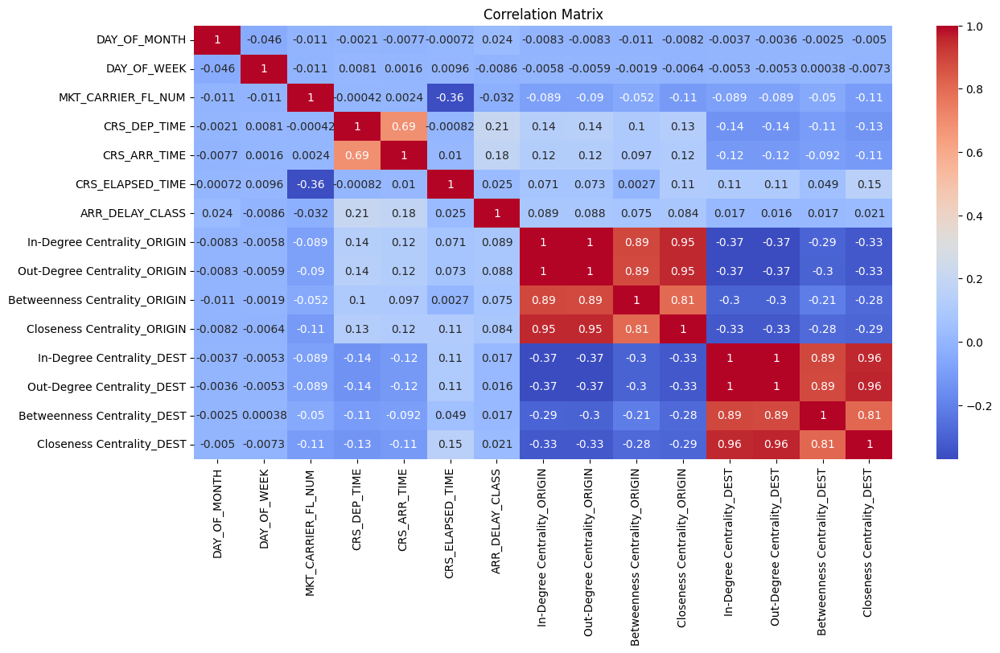

In [ ]:
plt.figure(figsize=(14,7))
numerical_df = data.select_dtypes(include=['number'])
correlation_matrix = numerical_df.corr()
print(correlation_matrix)
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix')
plt.show()


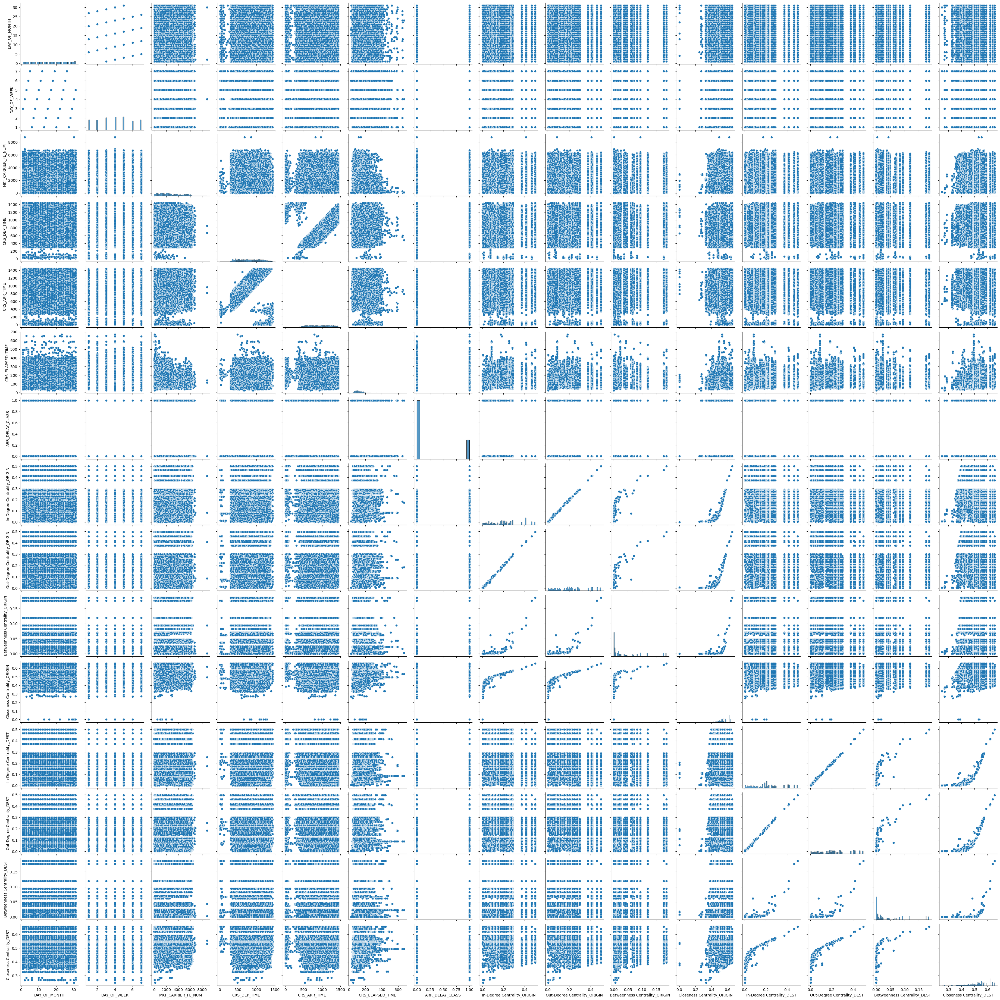

In [ ]:
sns.pairplot(data)

### Encoding Categorical Data

In [43]:
# Applying One-Hot Encoding to the "MKT_UNIQUE_CARRIER" column
data = pd.get_dummies(data, columns=['MKT_UNIQUE_CARRIER'], prefix='MKT_UNIQUE_CARRIER')
for col in data.columns:
    if col.startswith('MKT_UNIQUE_CARRIER_'):
        data[col] = data[col].astype(int)
data.head()

,DAY_OF_MONTH,DAY_OF_WEEK,MKT_CARRIER_FL_NUM,ORIGIN,DEST,CRS_DEP_TIME,CRS_ARR_TIME,CRS_ELAPSED_TIME,ARR_DELAY_CLASS,Out-Degree Centrality_ORIGIN,...,MKT_UNIQUE_CARRIER_AA,MKT_UNIQUE_CARRIER_AS,MKT_UNIQUE_CARRIER_B6,MKT_UNIQUE_CARRIER_DL,MKT_UNIQUE_CARRIER_F9,MKT_UNIQUE_CARRIER_G4,MKT_UNIQUE_CARRIER_HA,MKT_UNIQUE_CARRIER_NK,MKT_UNIQUE_CARRIER_UA,MKT_UNIQUE_CARRIER_WN
0,1,3,1,JFK,LAX,540,749,389.0,0,0.188034,...,1,0,0,0,0,0,0,0,0,0
1,1,3,523,JFK,LAX,580,768,368.0,1,0.188034,...,0,0,1,0,0,0,0,0,0,0
2,1,3,323,JFK,LAX,530,720,370.0,1,0.188034,...,0,0,1,0,0,0,0,0,0,0
3,1,3,685,JFK,LAX,585,780,375.0,0,0.188034,...,0,0,0,1,0,0,0,0,0,0
4,1,3,482,JFK,LAX,495,690,375.0,0,0.188034,...,0,0,0,1,0,0,0,0,0,0


In [44]:
# Applying One-Hot Encoding to the "ORIGIN" column
data = pd.get_dummies(data, columns=['ORIGIN'], prefix='ORIGIN')
for col in data.columns:
    if col.startswith('ORIGIN_'):
        data[col] = data[col].astype(int)
data.head()

,DAY_OF_MONTH,DAY_OF_WEEK,MKT_CARRIER_FL_NUM,DEST,CRS_DEP_TIME,CRS_ARR_TIME,CRS_ELAPSED_TIME,ARR_DELAY_CLASS,Out-Degree Centrality_ORIGIN,In-Degree Centrality_DEST,...,ORIGIN_VCT,ORIGIN_VLD,ORIGIN_VPS,ORIGIN_WRG,ORIGIN_WYS,ORIGIN_XNA,ORIGIN_XWA,ORIGIN_YAK,ORIGIN_YKM,ORIGIN_YUM
0,1,3,1,LAX,540,749,389.0,0,0.188034,0.262108,...,0,0,0,0,0,0,0,0,0,0
1,1,3,523,LAX,580,768,368.0,1,0.188034,0.262108,...,0,0,0,0,0,0,0,0,0,0
2,1,3,323,LAX,530,720,370.0,1,0.188034,0.262108,...,0,0,0,0,0,0,0,0,0,0
3,1,3,685,LAX,585,780,375.0,0,0.188034,0.262108,...,0,0,0,0,0,0,0,0,0,0
4,1,3,482,LAX,495,690,375.0,0,0.188034,0.262108,...,0,0,0,0,0,0,0,0,0,0


In [1]:
# Applying One-Hot Encoding to the "DEST" column
data = pd.get_dummies(data, columns=['DEST'], prefix='DEST')
for col in data.columns:
    if col.startswith('DEST_'):
        data[col] = data[col].astype(int)
data.head()

NameError: name 'pd' is not defined

### Features (X) and target (y) variable

In [2]:
X = data.drop(columns=['ARR_DELAY_CLASS'])
y = data['ARR_DELAY_CLASS']

NameError: name 'data' is not defined

### Feature Importance using Information Gain

In [ ]:
# Calculating the Information Gain for each feature
information_gain = mutual_info_classif(X, y, discrete_features='auto')

# Creating a DataFrame to view the results
info_gain_df = pd.DataFrame({'Feature': X.columns, 'Information Gain': information_gain})

# Sorting the features by Information Gain
info_gain_df = info_gain_df.sort_values(by='Information Gain', ascending=False)
info_gain_df.head(20)

,Feature,Information Gain
3,CRS_DEP_TIME,0.027795
4,CRS_ARR_TIME,0.026023
2,MKT_CARRIER_FL_NUM,0.014820
9,Closeness Centrality_ORIGIN,0.009162
7,Out-Degree Centrality_ORIGIN,0.008773
0,DAY_OF_MONTH,0.007733
6,In-Degree Centrality_ORIGIN,0.007470
8,Betweenness Centrality_ORIGIN,0.007137
391,DEST_ALO,0.005878
10,In-Degree Centrality_DEST,0.005282


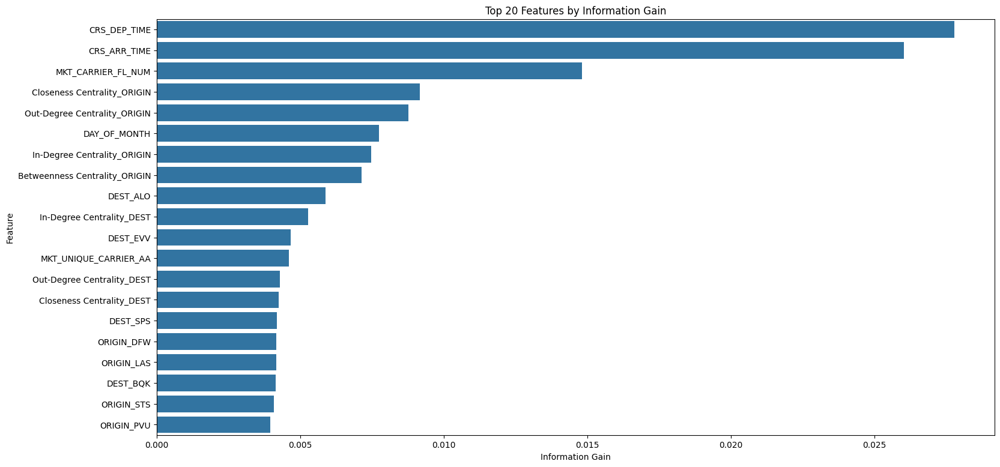

In [ ]:
# plot the top 20 results for information gain
top_20_info_gain = info_gain_df.head(20)

plt.figure(figsize=(18, 9))
sns.barplot(x='Information Gain', y='Feature', data=top_20_info_gain)
plt.title('Top 20 Features by Information Gain')
plt.xlabel('Information Gain')
plt.ylabel('Feature')
plt.show()

## Model Training

## K-Fold Cross Vallidation

In [1]:
# Initializing KFold with 5 splits
kf = KFold(n_splits=5, shuffle=True, random_state=42)

NameError: name 'KFold' is not defined

### Decision Tree Classifier

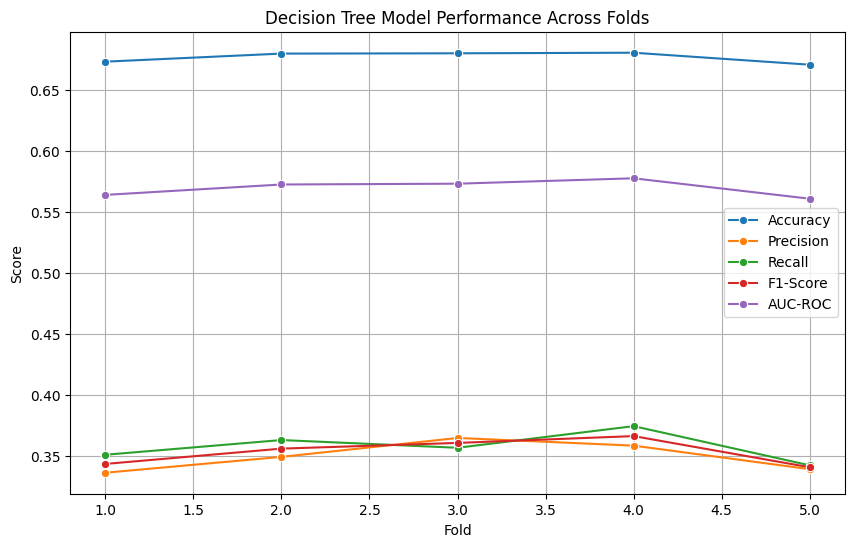

Mean Accuracy: 0.6766643399546179
Mean Precision: 0.3494631445027669
Mean Recall: 0.3573795162593678
Mean F1-Score: 0.35331797026412237
Mean AUC-ROC: 0.5694581568628772


In [ ]:
# Initializing the Decision Tree classifier
dt_model = DecisionTreeClassifier(random_state=42)

# Defining scoring metrics
scoring = {
    'accuracy': 'accuracy',
    'precision': 'precision',
    'recall': 'recall',
    'f1': 'f1',
    'roc_auc': 'roc_auc'
}

# cross-validation
cv_results = cross_validate(dt_model, X, y, cv=kf, scoring=scoring)

# Extracting the metrics
accuracy = cv_results['test_accuracy']
precision = cv_results['test_precision']
recall = cv_results['test_recall']
f1 = cv_results['test_f1']
roc_auc = cv_results['test_roc_auc']

# Creating a DataFrame to hold the results
metrics_df = pd.DataFrame({
    'Fold': np.arange(1, kf.get_n_splits(X) + 1),
    'Accuracy': accuracy,
    'Precision': precision,
    'Recall': recall,
    'F1-Score': f1,
    'AUC-ROC': roc_auc
})

# Plotting the results
plt.figure(figsize=(10, 6))
sns.lineplot(data=metrics_df, x='Fold', y='Accuracy', marker='o', label='Accuracy')
sns.lineplot(data=metrics_df, x='Fold', y='Precision', marker='o', label='Precision')
sns.lineplot(data=metrics_df, x='Fold', y='Recall', marker='o', label='Recall')
sns.lineplot(data=metrics_df, x='Fold', y='F1-Score', marker='o', label='F1-Score')
sns.lineplot(data=metrics_df, x='Fold', y='AUC-ROC', marker='o', label='AUC-ROC')

plt.title('Decision Tree Model Performance Across Folds')
plt.xlabel('Fold')
plt.ylabel('Score')
plt.legend()
plt.grid(True)
plt.show()


print(f'Mean Accuracy: {accuracy.mean()}')
print(f'Mean Precision: {precision.mean()}')
print(f'Mean Recall: {recall.mean()}')
print(f'Mean F1-Score: {f1.mean()}')
print(f'Mean AUC-ROC: {roc_auc.mean()}')

### Logistic Regression

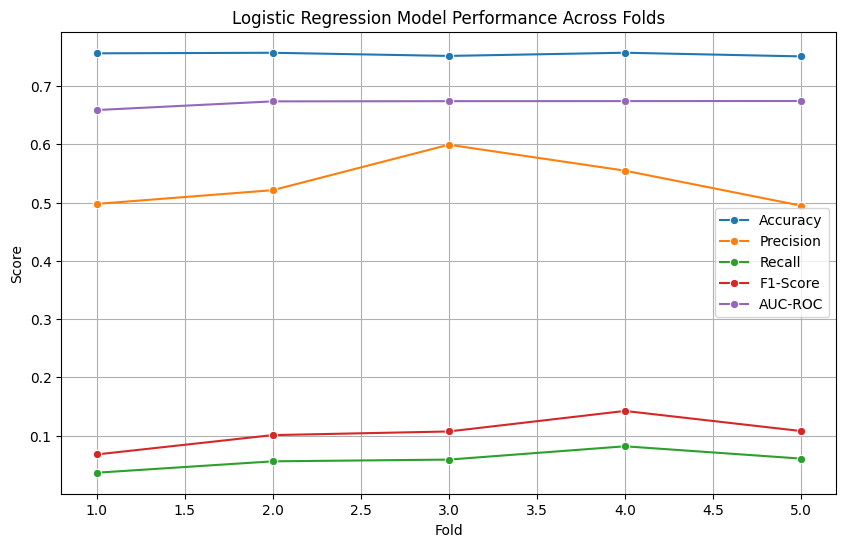

Mean Accuracy: 0.754720225982082
Mean Precision: 0.5336094489233018
Mean Recall: 0.05860313768903639
Mean F1-Score: 0.10513556400150181
Mean AUC-ROC: 0.6710949278881839


In [ ]:
# Initializing Logistic Regression model
model = LogisticRegression(max_iter=1000)

# Defining scoring metrics
scoring = {
    'accuracy': 'accuracy',
    'precision': 'precision',
    'recall': 'recall',
    'f1': 'f1',
    'roc_auc': 'roc_auc'
}

# cross-validation
cv_results = cross_validate(model, X, y, cv=kf, scoring=scoring)

# Extracting the metrics
accuracy = cv_results['test_accuracy']
precision = cv_results['test_precision']
recall = cv_results['test_recall']
f1 = cv_results['test_f1']
roc_auc = cv_results['test_roc_auc']

# Creating a DataFrame to hold the results
metrics_df = pd.DataFrame({
    'Fold': np.arange(1, kf.get_n_splits(X) + 1),
    'Accuracy': accuracy,
    'Precision': precision,
    'Recall': recall,
    'F1-Score': f1,
    'AUC-ROC': roc_auc
})

# Plotting the results
plt.figure(figsize=(10, 6))
sns.lineplot(data=metrics_df, x='Fold', y='Accuracy', marker='o', label='Accuracy')
sns.lineplot(data=metrics_df, x='Fold', y='Precision', marker='o', label='Precision')
sns.lineplot(data=metrics_df, x='Fold', y='Recall', marker='o', label='Recall')
sns.lineplot(data=metrics_df, x='Fold', y='F1-Score', marker='o', label='F1-Score')
sns.lineplot(data=metrics_df, x='Fold', y='AUC-ROC', marker='o', label='AUC-ROC')

plt.title('Logistic Regression Model Performance Across Folds')
plt.xlabel('Fold')
plt.ylabel('Score')
plt.legend()
plt.grid(True)
plt.show()

print(f'Mean Accuracy: {accuracy.mean()}')
print(f'Mean Precision: {precision.mean()}')
print(f'Mean Recall: {recall.mean()}')
print(f'Mean F1-Score: {f1.mean()}')
print(f'Mean AUC-ROC: {roc_auc.mean()}')

### K-Nearest Neighbors Classifier

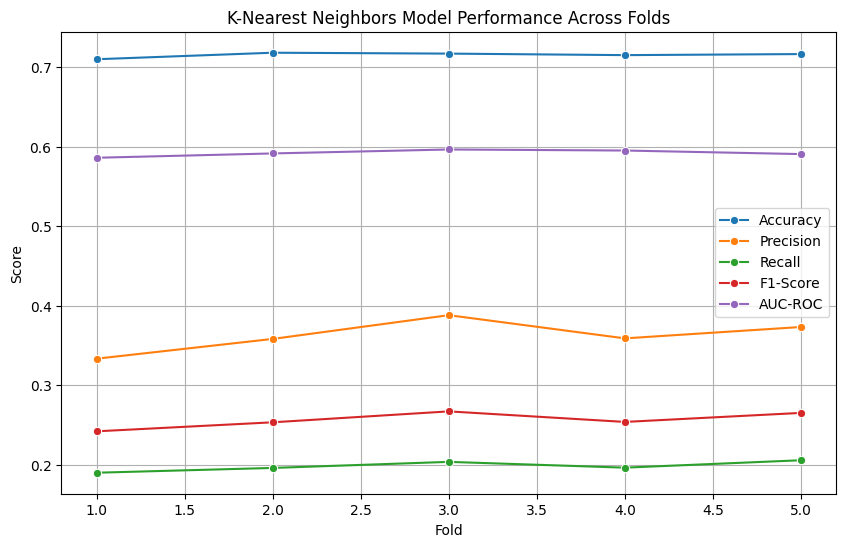

Mean Accuracy: 0.7154933790597158
Mean Precision: 0.3625284121519374
Mean Recall: 0.1984794444487211
Mean F1-Score: 0.25647799363997603
Mean AUC-ROC: 0.592121155284724


In [ ]:
# Initializing the K-Nearest Neighbors classifier
knn_model = KNeighborsClassifier(n_neighbors=5)

# Defining scoring metrics
scoring = {
    'accuracy': 'accuracy',
    'precision': 'precision',
    'recall': 'recall',
    'f1': 'f1',
    'roc_auc': 'roc_auc'
}

# cross-validation
cv_results = cross_validate(knn_model, X, y, cv=kf, scoring=scoring)

# Extracting the metrics
accuracy = cv_results['test_accuracy']
precision = cv_results['test_precision']
recall = cv_results['test_recall']
f1 = cv_results['test_f1']
roc_auc = cv_results['test_roc_auc']

# Creating a DataFrame to hold the results
metrics_df = pd.DataFrame({
    'Fold': np.arange(1, kf.get_n_splits(X) + 1),
    'Accuracy': accuracy,
    'Precision': precision,
    'Recall': recall,
    'F1-Score': f1,
    'AUC-ROC': roc_auc
})

# Plotting the results
plt.figure(figsize=(10, 6))
sns.lineplot(data=metrics_df, x='Fold', y='Accuracy', marker='o', label='Accuracy')
sns.lineplot(data=metrics_df, x='Fold', y='Precision', marker='o', label='Precision')
sns.lineplot(data=metrics_df, x='Fold', y='Recall', marker='o', label='Recall')
sns.lineplot(data=metrics_df, x='Fold', y='F1-Score', marker='o', label='F1-Score')
sns.lineplot(data=metrics_df, x='Fold', y='AUC-ROC', marker='o', label='AUC-ROC')

plt.title('K-Nearest Neighbors Model Performance Across Folds')
plt.xlabel('Fold')
plt.ylabel('Score')
plt.legend()
plt.grid(True)
plt.show()

print(f'Mean Accuracy: {accuracy.mean()}')
print(f'Mean Precision: {precision.mean()}')
print(f'Mean Recall: {recall.mean()}')
print(f'Mean F1-Score: {f1.mean()}')
print(f'Mean AUC-ROC: {roc_auc.mean()}')

### Random Forest Classifier

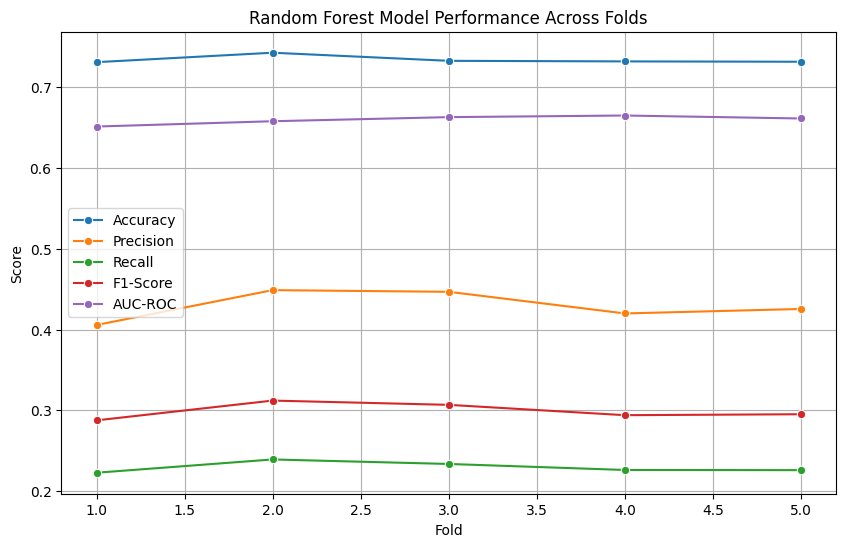

Mean Accuracy: 0.7340879033831247
Mean Precision: 0.429386094513193
Mean Recall: 0.22957497749918332
Mean F1-Score: 0.29916938022297124
Mean AUC-ROC: 0.6597915328324099


In [ ]:
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)

# Defining scoring metrics
scoring = {
    'accuracy': 'accuracy',
    'precision': 'precision',
    'recall': 'recall',
    'f1': 'f1',
    'roc_auc': 'roc_auc'
}

# cross-validation
cv_results = cross_validate(rf_model, X, y, cv=kf, scoring=scoring)

# Extracting the metrics
accuracy = cv_results['test_accuracy']
precision = cv_results['test_precision']
recall = cv_results['test_recall']
f1 = cv_results['test_f1']
roc_auc = cv_results['test_roc_auc']

# Creating a DataFrame to hold the results
metrics_df = pd.DataFrame({
    'Fold': np.arange(1, kf.get_n_splits(X) + 1),
    'Accuracy': accuracy,
    'Precision': precision,
    'Recall': recall,
    'F1-Score': f1,
    'AUC-ROC': roc_auc
})

# Plotting the results
plt.figure(figsize=(10, 6))
sns.lineplot(data=metrics_df, x='Fold', y='Accuracy', marker='o', label='Accuracy')
sns.lineplot(data=metrics_df, x='Fold', y='Precision', marker='o', label='Precision')
sns.lineplot(data=metrics_df, x='Fold', y='Recall', marker='o', label='Recall')
sns.lineplot(data=metrics_df, x='Fold', y='F1-Score', marker='o', label='F1-Score')
sns.lineplot(data=metrics_df, x='Fold', y='AUC-ROC', marker='o', label='AUC-ROC')

plt.title('Random Forest Model Performance Across Folds')
plt.xlabel('Fold')
plt.ylabel('Score')
plt.legend()
plt.grid(True)
plt.show()


print(f'Mean Accuracy: {accuracy.mean()}')
print(f'Mean Precision: {precision.mean()}')
print(f'Mean Recall: {recall.mean()}')
print(f'Mean F1-Score: {f1.mean()}')
print(f'Mean AUC-ROC: {roc_auc.mean()}')

### XGBoost Classifier

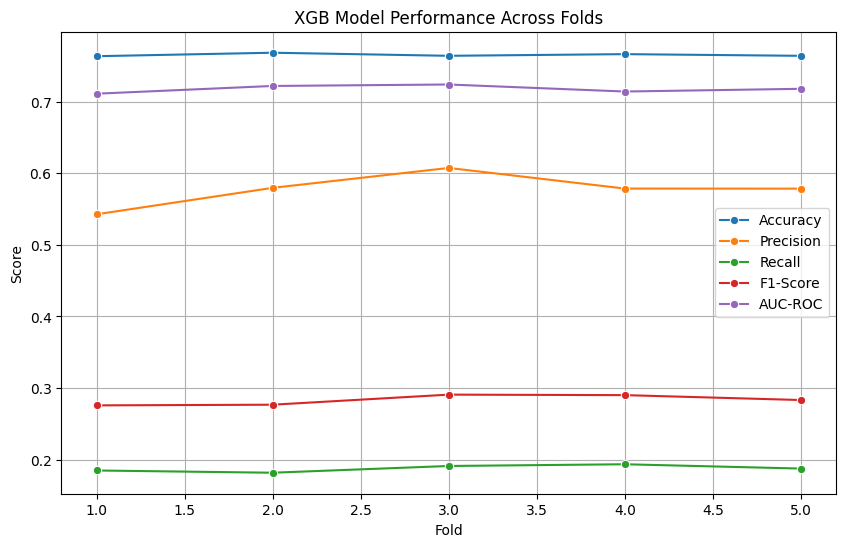

Mean Accuracy: 0.7651956375181932
Mean Precision: 0.5773468859828542
Mean Recall: 0.18781624825806612
Mean F1-Score: 0.28337412602929263
Mean AUC-ROC: 0.7177735372644294


In [ ]:
xgb_model = XGBClassifier(eval_metric='logloss', random_state=42)

# Defining scoring metrics
scoring = {
    'accuracy': 'accuracy',
    'precision': 'precision',
    'recall': 'recall',
    'f1': 'f1',
    'roc_auc': 'roc_auc'
}

# cross-validation
cv_results = cross_validate(xgb_model, X, y, cv=kf, scoring=scoring)

# Extracting the metrics
accuracy = cv_results['test_accuracy']
precision = cv_results['test_precision']
recall = cv_results['test_recall']
f1 = cv_results['test_f1']
roc_auc = cv_results['test_roc_auc']

# Creating a DataFrame to hold the results
metrics_df = pd.DataFrame({
    'Fold': np.arange(1, kf.get_n_splits(X) + 1),
    'Accuracy': accuracy,
    'Precision': precision,
    'Recall': recall,
    'F1-Score': f1,
    'AUC-ROC': roc_auc
})

# Plotting the results
plt.figure(figsize=(10, 6))
sns.lineplot(data=metrics_df, x='Fold', y='Accuracy', marker='o', label='Accuracy')
sns.lineplot(data=metrics_df, x='Fold', y='Precision', marker='o', label='Precision')
sns.lineplot(data=metrics_df, x='Fold', y='Recall', marker='o', label='Recall')
sns.lineplot(data=metrics_df, x='Fold', y='F1-Score', marker='o', label='F1-Score')
sns.lineplot(data=metrics_df, x='Fold', y='AUC-ROC', marker='o', label='AUC-ROC')

plt.title('XGB Model Performance Across Folds')
plt.xlabel('Fold')
plt.ylabel('Score')
plt.legend()
plt.grid(True)
plt.show()

print(f'Mean Accuracy: {accuracy.mean()}')
print(f'Mean Precision: {precision.mean()}')
print(f'Mean Recall: {recall.mean()}')
print(f'Mean F1-Score: {f1.mean()}')
print(f'Mean AUC-ROC: {roc_auc.mean()}')

## Using Xtrain ytrain

In [ ]:
# Splitting the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

### Decision Tree Classifier

Accuracy: 0.6730080394810157
Classification Report:
              precision    recall  f1-score   support

           0       0.79      0.78      0.78      9502
           1       0.34      0.35      0.34      3061

    accuracy                           0.67     12563
   macro avg       0.56      0.56      0.56     12563
weighted avg       0.68      0.67      0.68     12563

Confusion Matrix:
[[7381 2121]
 [1987 1074]]


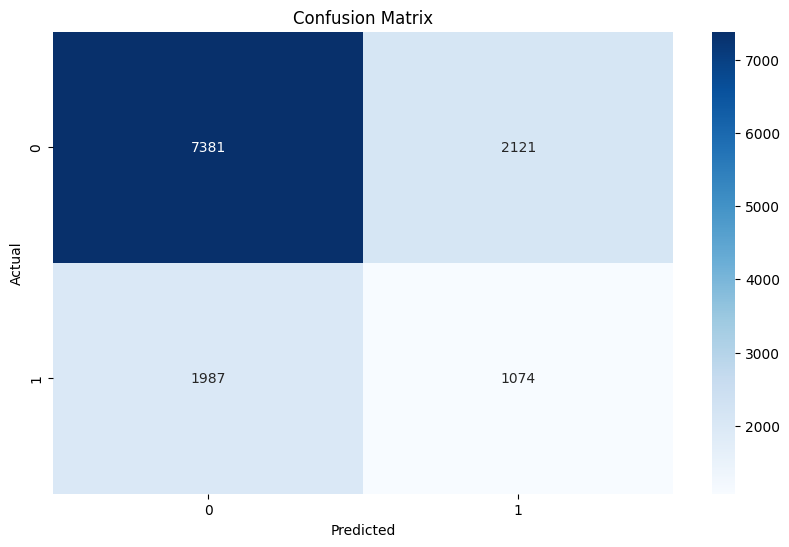

In [ ]:
dt_model = DecisionTreeClassifier(random_state=42)

# Training the model
dt_model.fit(X_train, y_train)

# Making predictions on the test set
y_pred = dt_model.predict(X_test)

# Evaluating the model
accuracy = accuracy_score(y_test, y_pred)
classification_rep = classification_report(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)

print(f"Accuracy: {accuracy}")
print("Classification Report:")
print(classification_rep)
print("Confusion Matrix:")
print(conf_matrix)

# plotting the results
plt.figure(figsize=(10,6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()


### Logistic Regression

Accuracy: 0.7577807848443843
Classification Report:
              precision    recall  f1-score   support

           0       0.76      0.98      0.86      9502
           1       0.53      0.06      0.10      3061

    accuracy                           0.76     12563
   macro avg       0.65      0.52      0.48     12563
weighted avg       0.71      0.76      0.68     12563

Confusion Matrix:
[[9342  160]
 [2883  178]]


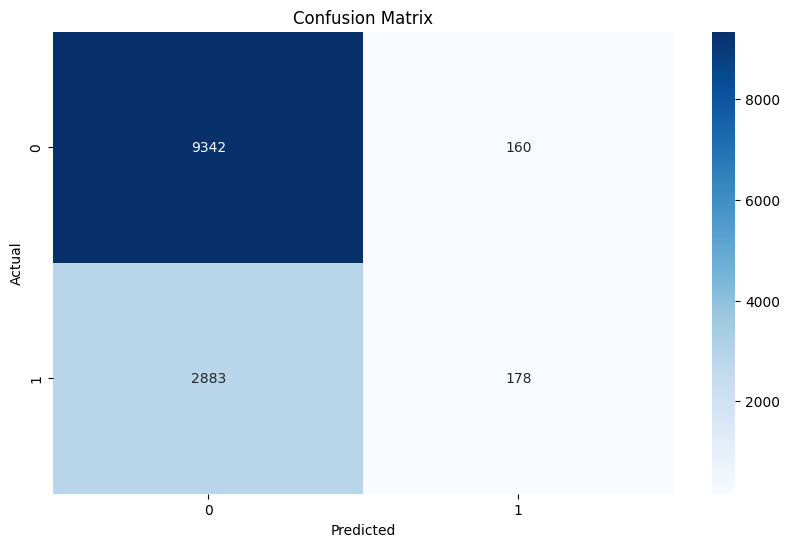

In [ ]:
model = LogisticRegression(max_iter=1000)

model.fit(X_train, y_train)

y_pred = model.predict(X_test)

accuracy = accuracy_score(y_test, y_pred)
classification_rep = classification_report(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)

print(f"Accuracy: {accuracy}")
print("Classification Report:")
print(classification_rep)
print("Confusion Matrix:")
print(conf_matrix)

# plotting the results
plt.figure(figsize=(10,6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

### K-Nearest Neighbors

Accuracy: 0.7100214916819231
Classification Report:
              precision    recall  f1-score   support

           0       0.77      0.88      0.82      9502
           1       0.33      0.19      0.24      3061

    accuracy                           0.71     12563
   macro avg       0.55      0.53      0.53     12563
weighted avg       0.66      0.71      0.68     12563

Confusion Matrix:
[[8338 1164]
 [2479  582]]


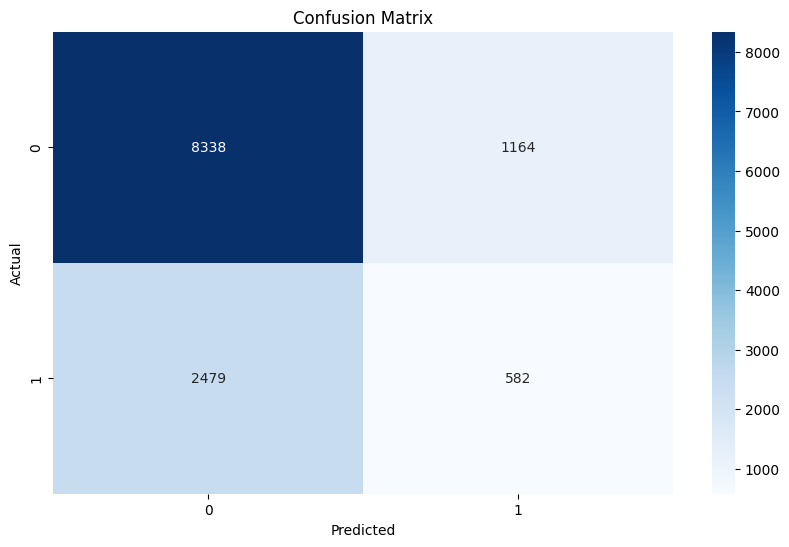

In [ ]:
knn_model = KNeighborsClassifier(n_neighbors=5)

knn_model.fit(X_train, y_train)

y_pred = knn_model.predict(X_test)

accuracy = accuracy_score(y_test, y_pred)
classification_rep = classification_report(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)

print(f"Accuracy: {accuracy}")
print("Classification Report:")
print(classification_rep)
print("Confusion Matrix:")
print(conf_matrix)

# plotting the results
plt.figure(figsize=(10,6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

### Random Forest Classifier

Accuracy: 0.7319111677147179
Classification Report:
              precision    recall  f1-score   support

           0       0.78      0.89      0.83      9502
           1       0.41      0.23      0.29      3061

    accuracy                           0.73     12563
   macro avg       0.60      0.56      0.56     12563
weighted avg       0.69      0.73      0.70     12563

Confusion Matrix:
[[8494 1008]
 [2360  701]]


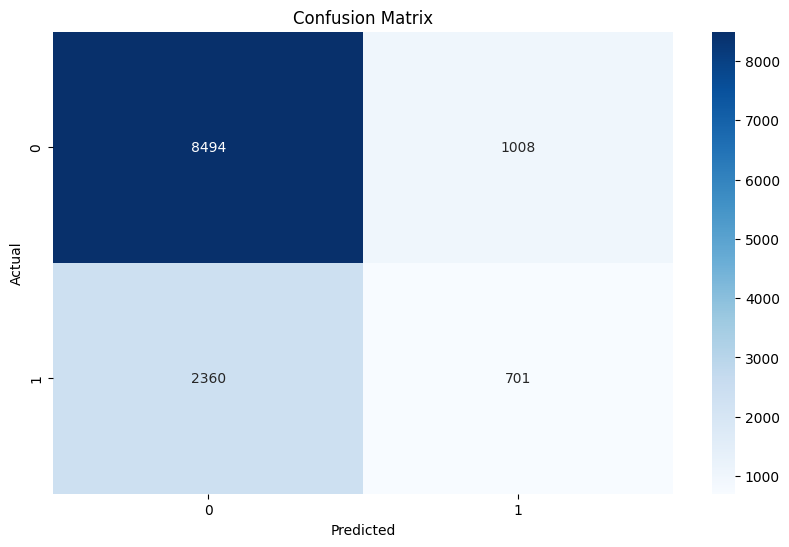

In [ ]:
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)

rf_model.fit(X_train, y_train)

y_pred = rf_model.predict(X_test)

accuracy = accuracy_score(y_test, y_pred)
classification_rep = classification_report(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)

print(f"Accuracy: {accuracy}")
print("Classification Report:")
print(classification_rep)
print("Confusion Matrix:")
print(conf_matrix)

# plotting the results
plt.figure(figsize=(10,6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

### XGB Classifier

Accuracy: 0.7634323012019422
Classification Report:
              precision    recall  f1-score   support

           0       0.78      0.95      0.86      9502
           1       0.54      0.18      0.28      3061

    accuracy                           0.76     12563
   macro avg       0.66      0.57      0.57     12563
weighted avg       0.72      0.76      0.72     12563

Confusion Matrix:
[[9025  477]
 [2495  566]]


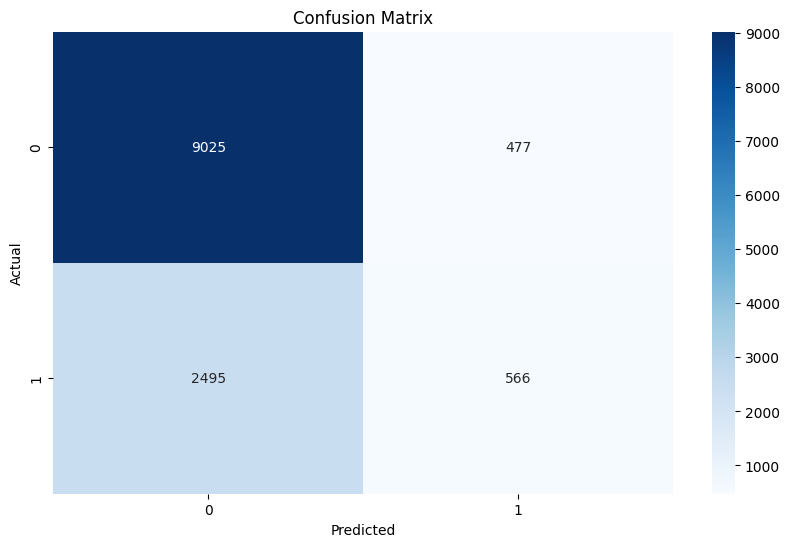

In [ ]:
xgb_model = XGBClassifier( eval_metric='logloss', random_state=42)

xgb_model.fit(X_train, y_train)

y_pred = xgb_model.predict(X_test)

accuracy = accuracy_score(y_test, y_pred)
classification_rep = classification_report(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)

print(f"Accuracy: {accuracy}")
print("Classification Report:")
print(classification_rep)
print("Confusion Matrix:")
print(conf_matrix)

# plotting the results
plt.figure(figsize=(10,6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()